## Chapter 03: Linear regression model
### A. Pyro modelling
### 1. Introduction
Operational data of a plant for the oxidation of ammonia to nitric acid.

“Obtained from 21 days of operation of a plant for the oxidation of ammonia (NH3) to nitric acid (HNO3). The nitric oxides produced are absorbed in a countercurrent absorption tower”. (Brownlee, cited by Dodge, slightly reformatted by MM.)

Air Flow represents the rate of operation of the plant. Water Temp is the temperature of cooling water circulated through coils in the absorption tower. Acid Conc. is the concentration of the acid circulating, minus 50, times 10: that is, 89 corresponds to 58.9 per cent acid. stack.loss (the dependent variable) is 10 times the percentage of the ingoing ammonia to the plant that escapes from the absorption column unabsorbed; that is, an (inverse) measure of the over-all efficiency of the plant.

In [1]:
import os
from functools import partial
import torch
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly
import pyro
from scipy import stats
import pyro.distributions as dist
from torch import nn
from pyro.nn import PyroModule
from pyro.infer import MCMC, NUTS

import random
import numpy as np
import time
import random
import pandas as pd
from collections import defaultdict
import plotly.express as px
import re
import itertools

from chapter03 import base

pyro.set_rng_seed(1)

plt.style.use('default')

%matplotlib inline
%load_ext autoreload

#### Data
<br>
stacks data

**Following standardises Data**

In [3]:


# @staticmethod
# def load_data():
#     transform_data= lambda x:torch.tensor(stats.zscore(x), dtype=torch.float)# standardises Input data
#     stacks_data = {"p":3, "N":21, "Y":[43, 37, 37, 28, 18, 18, 19, 20, 15, 14, 14, 13, 11, 12, 8, 
#         7, 8, 8, 9, 15, 15], "x":[80, 80, 75, 62, 62, 62, 62, 62, 59, 58, 58, 58, 58, 
#         58, 50, 50, 50, 50, 50, 56, 70, 27, 27, 25, 24, 22, 23, 24, 24, 
#         23, 18, 18, 17, 18, 19, 18, 18, 19, 19, 20, 20, 20, 89, 88, 90, 
#         87, 87, 87, 93, 93, 87, 80, 89, 88, 82, 93, 89, 86, 72, 79, 80, 
#         82, 91]}
    
#     x_data= torch.tensor(np.array(stacks_data["x"]).reshape((stacks_data["N"], stacks_data["p"])), dtype=torch.float)
#     y_data= torch.tensor(stacks_data["Y"], dtype=torch.float)
#     stacks_data_ = []
#     for idx in range(stacks_data["p"]):
#         stacks_data_.append(transform_data(x_data[:,idx]))
    
#     stacks_data_.append(y_data)
#     return stacks_data_

In [4]:
# X1, X2, X3, Y = load_data()
X1, X2, X3, Y = base.load_data()

print("X1: %s\nX2: %s\nX3: %s\nY: %s"%(X1.shape, X2.shape, X3.shape, Y.shape))

X1: torch.Size([21])
X2: torch.Size([21])
X3: torch.Size([21])
Y: torch.Size([21])


### 2. Model Specification
________
**Stack Model definition**

**beta0 ~ normal(0, 316);**

**beta ~ normal(0, 316);**

**sigmasq ~ inv_gamma(.001, .001);**

In [8]:
# def init_priors(prior_dict={"default":dist.Normal(0., 316.)}):
#     """
#     Input
#     -------



#     Output
#     --------
#     """
#     prior_dict["names"]= prior_dict.get("names") if prior_dict.get("names") else ["beta0", "beta1", "beta2", "beta3", "sigma"]
#     if not prior_dict.get("default"):
#         raise Exception("pass a deafault distribution to key 'default' for parameters ['beta0', 'beta1', 'beta2', 'beta3', 'sigma']}")
#     prior_list = []
#     [prior_list.append(prior_dict.get(param, prior_dict.get("default"))) for param in prior_dict.get("names")];
#     return prior_list


# def get_prior_samples(num_samples=1100, **kwargs):
#     """
#     Input
#     -------



#     Output
#     --------
#     """
#     prior_samples={}
#     for param, param_prior in kwargs.items():
#         sample_list = list(map(lambda k: pyro.sample(param, param_prior).item(), range(num_samples)))
#         prior_samples[param]=sample_list
#     return prior_samples


In [169]:
num_samples = 1100 

# beta0_prior, beta1_prior, beta2_prior, beta3_prior, sigma_prior= init_priors({"default":dist.Normal(0, 316.),
#                                                                              "sigma":dist.InverseGamma(0.001, 0.001)})# Pass priors for model A
# prior_samples_dict = get_prior_samples(num_samples=num_samples, beta0= beta0_prior, beta1= beta1_prior, 
#                                     beta2= beta2_prior, beta3=beta3_prior, sigma=sigma_prior)

beta0_prior, beta1_prior, beta2_prior, beta3_prior, sigma_prior= base.init_priors({"default":dist.Normal(316.),
                                                                             "sigma":dist.InverseGamma(0.001, 0.001)})# Pass priors for model A
prior_samples_dict = base.get_prior_samples(num_samples=num_samples, beta0= beta0_prior, beta1= beta1_prior, 
                                    beta2= beta2_prior, beta3=beta3_prior, sigma=sigma_prior)


### 3. Prior predictive checking

Prior predictive checking (PiPC)

In [524]:
# original_plus_simulated_data_prior, original_plus_simulated_prior_df = base.simulate_observations_given_prior_posterior_pairs(Y, 
#                                                                                                                     model_normal_a= prior_samples_dict)

original_plus_simulated_data_prior, original_plus_simulated_prior_df = simulate_observations_given_prior_posterior_pairs(Y, 
                                                                                                                    model_normal_a= prior_samples_dict)



___________

For model 'model_normal_a' prior
total samples count: 1100  sample example:  [(-143.31483459472656, -386.7309875488281, -265.2214050292969, -223.08697509765625, 8.50705957708709e+34), (-22.07568359375, 511.3846740722656, -145.42103576660156, 178.79824829101562, 8.50705957708709e+34)]
Total execution time: 0.04188084602355957


_______________________________________________________
______________________________________________________________________
'prior_day_X' corresponds to observations simulated from prior of the given model, , 'day_X *' corresponds to the original observations for N-th day.


### 4. Posterior Estimation

In the Bayesian setting, inference is drawn from the posterior.  Here, posterior implies the updated beliefs about the random variables, in the wake of given evidences (data). Formally,
<br>
<br>
$Posterior = \frac {Likelihood x Prior}{Probability \ of Evidence}$
<br>
<br>
In our case, $\alpha,\beta$ are the parameters (actually random variables) & $y$ is the evidence;  According to the Bayes rule, Posterior $P(\alpha,\beta | y)$ is given as:
<br>
<br>
$P\ (\alpha,\beta | y) = \frac {P(y | \alpha,\beta) \pi(\alpha,\beta)}{P(y)}$
<br>
<br>

Now our interest is in estimating the posterior summaries of the parameters $\alpha, \beta$. For example, we can look at the posterior of mean of $\alpha$, denoted as $E(\alpha)$. However, in order to the get the posterior quanitities, either we need to compute the integrals or approximate the integrals via _Markov Chain Monte Carlo_. 

The latter can be easily accomplished in Pyro by using the [NUTS](https://arxiv.org/pdf/1111.4246.pdf) sampler -- NUTS is a specific sampler designed to draw samples efficiently from the posterior using _Hamiltonian Monte Carlo dynamics_.

The following code snippet takes a [pyro](http://pyro.ai/examples/intro_part_i.html) model object with -- posterior specification, input data, some configuration parameters such as a number of chains and number of samples per chain. It then launches a NUTS sampler and produces MCMC samples in a python dictionary format.

In [28]:
# def get_hmc_n_chains(pyromodel, x1, x2, x3, y, num_chains=4, sample_count = 1000, 
#                      burnin_percentage = 0.1, thining_percentage =0.9, 
#                      beta_prior = None, sigma_prior= None, **kwargs):
#         """
#         Input
#         -------
#         pyromodel: Pyro model object with specific prior distribution
#         xa: tensor holding avoidance count for all dogs & all trials
#         xs: tensor holding shock count for all dogs & all trials
#         y: tensor holding response observation for all dogs & all trials
#         num_chains: Count of MCMC chains to launch, default 4
#         sample_count: count of samples expected in a MCMC chains , default 1000
#         burnin_percentage:
#         thining_percentage: 

#         Outputs
#         ---------
#         hmc_sample_chains: a dictionary with chain names as keys & dictionary of parameter vs sampled values list as values 
#         hmc_chain_diagnostics: a dictionary with chain names as keys & dictionary of chain diagnostic metric values from hmc sampling. 

#         """
#         hmc_sample_chains =defaultdict(dict)
#         hmc_chain_diagnostics =defaultdict(dict)

#         net_sample_count= round(sample_count/((1- burnin_percentage)*(1- thining_percentage)))

#         t1= time.time()
#         for idx in range(num_chains):
#             num_samples, burnin= net_sample_count, round(net_sample_count*burnin_percentage)
#             nuts_kernel = NUTS(pyromodel)
#             mcmc = MCMC(nuts_kernel, num_samples=num_samples, warmup_steps=burnin)
#             mcmc.run(x1, x2, x3, y, beta_prior= beta_prior, sigma_prior= sigma_prior, **kwargs)
#             hmc_sample_chains['chain_{}'.format(idx)]={k: v.detach().cpu().numpy() for k, v in mcmc.get_samples().items()}
#             hmc_chain_diagnostics['chain_{}'.format(idx)]= mcmc.diagnostics()

#         print("\nTotal time: ", time.time()-t1)
#         hmc_sample_chains= dict(hmc_sample_chains)
#         hmc_chain_diagnostics= dict(hmc_chain_diagnostics)

#         return hmc_sample_chains, hmc_chain_diagnostics

In [30]:
# hmc_sample_chains_a, hmc_chain_diagnostics_a = base.get_hmc_n_chains(StackModel, X1, X2, X3, Y, num_chains=1, 
#                                                                      sample_count = 200, beta_prior= dist.Normal(0., 316.), 
#                                                                      sigma_prior= dist.InverseGamma(0.001, 0.001))


hmc_sample_chains_a, hmc_chain_diagnostics_a = get_hmc_n_chains(StackModel, X1, X2, X3, Y, num_chains=2, 
                                                                     sample_count = 200, beta_prior= dist.Normal(0., 316.), 
                                                                     sigma_prior= dist.InverseGamma(0.001, 0.001))



# (xa, xs, y, beta_prior= dist.Normal(0., 316.), sigma_prior= dist.InverseGamma(0.001, 0.001))



Sample: 100%|██████████████████████| 2444/2444 [01:51, 21.88it/s, step size=7.97e-02, acc. prob=0.940]


Total time:  214.29081296920776


In [6]:
# hmc_sample_chains= get_hmc_n_chains(num_chains=4, base_count = 900)

Sample: 100%|██████████| 1600/1600 [03:31,  7.57it/s, step size=8.37e-02, acc. prob=0.928]


Total time:  753.5873439311981


### 5. MCMC Diagnostics
Diagnosing the computational approximation

Just like any numerical technique, no matter how good the theory is or how robust the implementation is, it is always a good idea to check if indeed the samples drawn are reasonable. In the ideal situation, we expect the samples drawn by the sampler to be independant, and identically distributed (i.i.d) as the posterior distribution. In practice, this is far from true as MCMC itself is an approximate technique and a lot can go wrong. In particular, chains may not have converged or samples are very correlated. We can divide diagnosis into three sections.

- __Burn-in__: What is the effect of initialization? By visually inspecting the chains, we can notice the transient behaviour. We can drop the first "n" number of samples from the chain.

- __Thinning__: What is the intra chain correlation? We can use ACF (Auto-correlation function) to inspect it. A rule of thumb is, thin the chains such that, the ACF drops to $1/10^{th}$. Here, ACF drops to less than 0.1 at lag 5, then we retain only every $5^{th}$ sample in the chain.

- __Mixing__: Visually, all the chains, when plotted, should be indistinguishable from each other. At a very broad level, the means of the chains and variances shall be close. These are the two central moments we can track easily and turn them into Gelman-Rubin statistic. Other summmary statistics can be tracked, of course. 

We can use both visual and more formal statistical techniques to inspect the quality of the fit (not the model fit to the data, but how well the approximation is, having accepted the model class for the data at hand) by  treating chains as time-series data, and that we can run several chains in parallel. We precisely do that next. 

Following snippet allows plotting **Parameter vs. Chain matrix** and optionally saving the dataframe.

#### Model-A Summaries

**Parameter vs. Chain matrix**

In [54]:
# Unpruned sample chains for model A with HalfNormal prior

beta_chain_matrix_df_A = pd.DataFrame(hmc_sample_chains_a)

base.save_parameter_chain_dataframe(beta_chain_matrix_df_A, "data/stack_regression_hmc_sample_chains.csv")


In [7]:
# beta_chain_matrix_df = pd.DataFrame(hmc_sample_chains)
# # beta_chain_matrix_df.to_csv("stack_regression_hmc_sample_chains.csv", index=False)
# beta_chain_matrix_df

,chain_0,chain_1,chain_2,chain_3
beta0,"[18.71614, 16.050137, 17.946217, 18.919666, 16...","[24.57386, 23.213913, 23.238943, 22.17815, 18....","[16.606558, 16.587729, 16.519981, 16.988922, 1...","[16.872746, 16.055574, 17.874273, 16.715519, 1..."
beta1,"[-0.09374528, 14.835045, 12.376676, 13.508068,...","[-6.459302, -43.739346, -35.59753, -29.090143,...","[0.09798652, 6.6622844, 7.24026, 3.7635007, 6....","[9.801435, 4.937317, -7.2337184, -2.1739948, -..."
beta2,"[3.6648269, -13.366175, -13.43537, -11.334033,...","[9.3472595, 45.438457, 41.592846, 26.37089, 3....","[13.727935, 11.687968, 11.978772, 7.341863, 9....","[1.5280538, 10.590756, 14.111094, 10.4125805, ..."
beta3,"[-6.4204726, -2.1796389, -0.11578185, 1.136406...","[-7.3672466, -6.212668, -7.3795905, 1.4874831,...","[-10.425999, -11.553185, -10.667573, -15.08568...","[-11.4415245, -15.152795, -6.278599, -5.071878..."
sigma,"[83.27427, 87.956924, 109.809616, 80.93596, 14...","[212.35628, 224.96892, 206.13136, 207.47058, 2...","[119.16732, 134.67757, 134.24939, 130.3411, 14...","[122.17643, 113.59428, 120.55852, 106.82512, 1..."


##### A.1 Visual summary

###### A.1.1 Intermixing chains 
Sample chains mixing for `beta` & `sigma` parameters.

Following plots chains of samples for `beta` & `sigma` parameters for `model_a`

In [33]:
def plot_chains(param_chain_matrix_df):
    """
    Input
    -------
    param_chain_matrix_df: Dataframe holding samples of parameters (alpha & beta)
                        with parameter names across rows chain names across columns.

    Output
    -------
    Plot intermixing chains for each parameter.

    """
    for param in param_chain_matrix_df.index:
        plt.figure(figsize=(10,8))
        for chain in param_chain_matrix_df.columns:
            plt.plot(param_chain_matrix_df.loc[param, chain], label=chain)
            plt.legend()
        plt.title("Chain intermixing for '%s' samples"%param)
        plt.show()

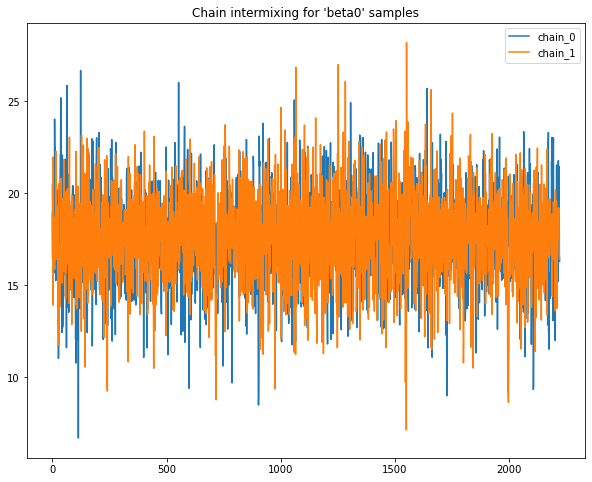

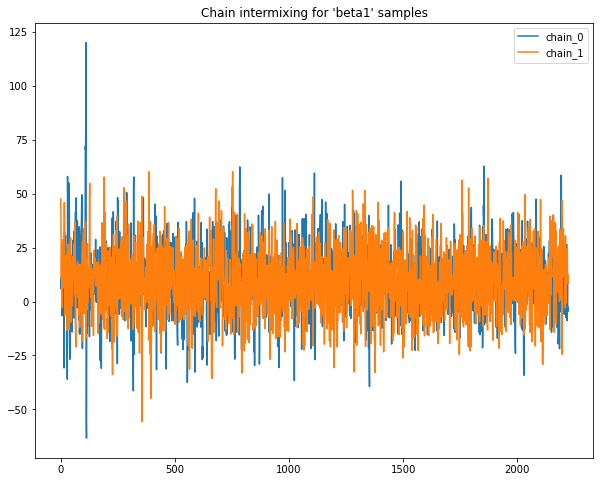

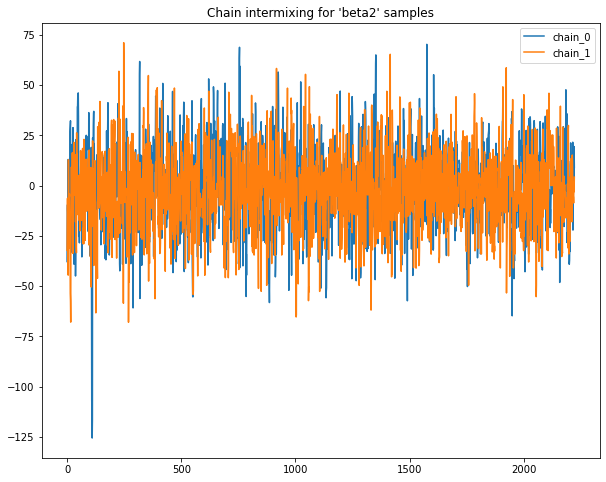

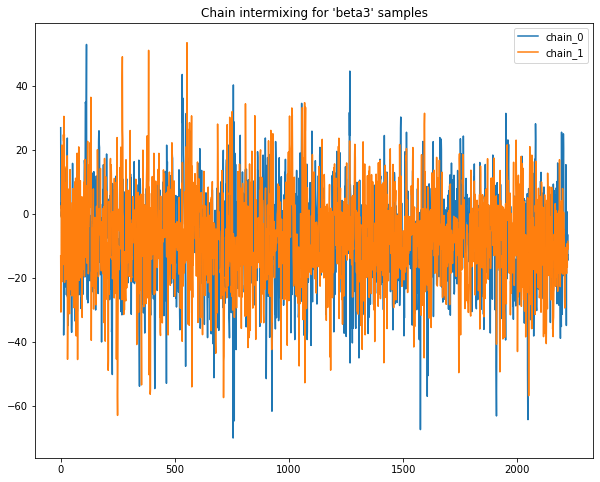

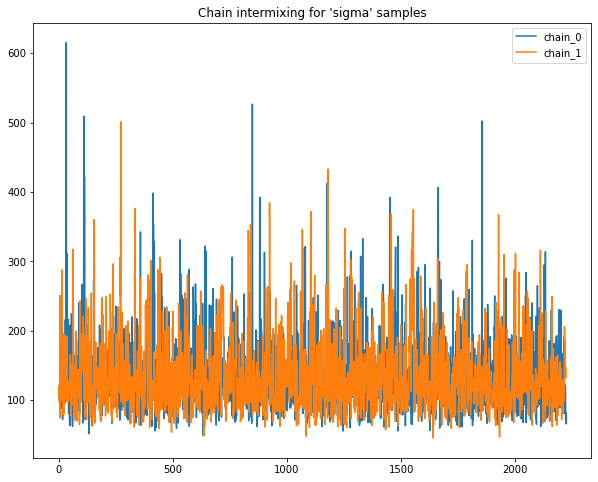

____
For 'model_a' chain_0
chain_0 Sample count:  2222
beta0 Q(0.5) :tensor(17.5137) | beta1 Q(0.5) :tensor(8.9822) | beta2 Q(0.5) :tensor(-1.8119) | beta3 Q(0.5) :tensor(-7.7062) | sigma Q(0.5) :tensor(123.8921)
____
For 'model_a' chain_1
chain_1 Sample count:  2222
beta0 Q(0.5) :tensor(17.6207) | beta1 Q(0.5) :tensor(10.1888) | beta2 Q(0.5) :tensor(-1.9594) | beta3 Q(0.5) :tensor(-7.8649) | sigma Q(0.5) :tensor(122.2477)


In [52]:

plot_chains(beta_chain_matrix_df_A)
# base.plot_chains(beta_chain_matrix_df_A)

for chain, samples in hmc_sample_chains_a.items():
    print("____\nFor 'model_a' %s"%chain)
    print_median = lambda param : "%s Q(0.5) :%s"%(param, torch.quantile(samples[param], 0.5))
    samples= dict(map(lambda param: (param, torch.tensor(samples.get(param))), samples.keys()))# np array to tensors
    print(chain, "Sample count: ", len(samples["sigma"]))
    print(" | ".join(map(print_median, samples.keys())))


##### A.2 Quantitative summary

###### A.2.1 ACF plots
Auto-correlation plots for sample chains of parameters

In [249]:
# from statsmodels.tsa.stattools import acf, pacf
# import plotly.graph_objects as go
# def plot_autocorrelation(beta_chain_matrix_df, parameters=None, chains= None, msize=8, lags= 40, plot_pacf=False):
#     lags= int(lags)
#     chains_list= chains if chains else list(beta_chain_matrix_df.columns)
#     parameters_list = parameters if parameters else list(beta_chain_matrix_df.index)

#     for param in parameters_list:
#         print("Autocorrelation for '%s'"%param)
#         fig= make_subplots()
#         for chain in chains_list:#["chain_0", "chain_1"]:
# #             plot_pacf= False
#             beta_chain_df_slice= pd.DataFrame(beta_chain_matrix_df.loc[param][chain])
#             corr_array = pacf(beta_chain_df_slice.dropna(), alpha=0.05, fft=False, nlags= lags) if plot_pacf else acf(beta_chain_df_slice.dropna(), alpha=0.05, fft=False, nlags= lags)

#             lower_y = corr_array[1][:,0] - corr_array[0]
#             upper_y = corr_array[1][:,1] - corr_array[0]

#             r, g, b= random.sample(range(0, 255), 3)
#             for x in range(len(corr_array[0])):
#                 fig.add_trace(go.Scatter(x=(x,x), y=(0,corr_array[0][x]), mode='lines',line_color='rgba(%s,%s,%s,0.9)'%(r, g,b), showlegend=False))

#         #     fig.add_trace(go.Scatter(x=(x,x), y=(0,corr_array[0][x]), mode='lines',line_color='rgba(%s,%s,%s,0.9)'%(r, g,b), name=chain))# To add legend for even line

#             fig.add_trace(go.Scatter(x=np.arange(len(corr_array[0])), y=corr_array[0], mode='markers', marker_color='rgba(%s, %s,%s,0.8)'%(r, g,b),
#                             marker_size=msize, name=chain))
#             fig.add_trace(go.Scatter(x=np.arange(len(corr_array[0])), y=upper_y, mode='lines', line_color='rgba(%s, %s,%s,0)'%(r, g,b), showlegend=False))
#             fig.add_trace(go.Scatter(x=np.arange(len(corr_array[0])), y=lower_y, mode='lines',fillcolor='rgba(%s,%s,%s,0.2)'%(r, g,b),
#                         fill='tonexty', line_color='rgba(255,255,255,0)', name=chain))
#         fig.update_layout(title="ACF plot for '%s' (all chains)\n\n"%param, legend_title="Chains")
#         fig.show()

In [250]:
#Optionally input parameters & chains of choice.
parameters=['beta0', 'beta1', 'beta2', 'beta3', 'sigma']
chains= ['chain_0', 'chain_1']

plot_autocorrelation(beta_chain_matrix_df_A, parameters= parameters, chains= chains)
# base.plot_autocorrelation(beta_chain_matrix_df_A, parameters= parameters, chains= chains)


Autocorrelation for 'beta0'


Autocorrelation for 'beta1'


Autocorrelation for 'beta2'


Autocorrelation for 'beta3'


Autocorrelation for 'sigma'



- For `beta0`, `thinin factor` for `chain_0` is 3, `chain_1` is 3, `chain_2` is 3, `chain_3` is 3.

- For `beta1`, `thinin factor` for `chain_0` is 3, `chain_1` is 3, `chain_2` is 3, `chain_3` is 3.

- For `beta2`, `thinin factor` for `chain_0` is 3, `chain_1` is 3, `chain_2` is 3, `chain_3` is 3.

- For `beta3`, `thinin factor` for `chain_0` is 3, `chain_1` is 3, `chain_2` is 3, `chain_3` is 3

- For `sigma`, `thining factor` for `chain_0` is 3, `chain_1` is 3, `chain_2` is 3, `chain_3` is 3.

Pruning chains from model

In [253]:
# def prune_hmc_samples(hmc_sample_chains, thining_dict):
#     """
#     Input
#     -------
#     hmc_sample_chains: a dictionary with chain names as keys & dictionary of parameter vs sampled values list as values 
#     thining_dict: a dictionary with chain names as keys & dictionary of parameter vs thining factor list as values 
#                   example:  {"chain_0": {"alpha":6, "beta":3}, "chain_1": {"alpha":7, "beta":3}}


#     Outputs
#     ---------
#     Outputs a pruned version of hmc_sample_chains in accordance with respective thining factors.

#     """
#     pruned_hmc_sample_chains= defaultdict(dict)
#     for chain, params_dict in hmc_sample_chains.items():
#         pruned_hmc_sample_chains[chain]= dict(map(lambda val: (val[0], params_dict[val[0]][0:-1:val[1]]), list(thining_dict[chain].items())))

#         original_sample_shape_dict= dict(map(lambda val: (val[0], val[1].shape), list(params_dict.items())))
#         pruned_sample_shape_dict = dict(map(lambda val: (val[0], val[1].shape), list(pruned_hmc_sample_chains[chain].items())))

#         print("%s\nOriginal sample counts for '%s' parameters: %s"%("-"*25, chain, original_sample_shape_dict))
#         print("\nThining factors for '%s' parameters: %s "%(chain, thining_dict[chain]))
#         print("Post thining sample counts for '%s' parameters: %s\n\n"%(chain, pruned_sample_shape_dict))

#     pruned_hmc_sample_chains= dict(pruned_hmc_sample_chains)

#     return pruned_hmc_sample_chains

In [254]:
thining_dict_a = {"chain_0": {'beta0': 3, 'beta1': 3, 'beta2': 3, 'beta3': 3, 'sigma': 3},
                  "chain_1": {'beta0': 3, 'beta1': 3, 'beta2': 3, 'beta3': 3, 'sigma': 3}, 
                 "chain_2": {'beta0': 3, 'beta1': 3, 'beta2': 3, 'beta3': 3, 'sigma': 3}, 
                 "chain_3": {'beta0': 3, 'beta1': 3, 'beta2': 3, 'beta3': 3, 'sigma': 3}}

pruned_hmc_sample_chains_a = prune_hmc_samples(hmc_sample_chains_a, thining_dict_a)
# pruned_hmc_sample_chains_a = base.prune_hmc_samples(hmc_sample_chains_a, thining_dict_a)


-------------------------
Original sample counts for 'chain_0' parameters: {'beta0': (2222,), 'beta1': (2222,), 'beta2': (2222,), 'beta3': (2222,), 'sigma': (2222,)}

Thining factors for 'chain_0' parameters: {'beta0': 3, 'beta1': 3, 'beta2': 3, 'beta3': 3, 'sigma': 3} 
Post thining sample counts for 'chain_0' parameters: {'beta0': (741,), 'beta1': (741,), 'beta2': (741,), 'beta3': (741,), 'sigma': (741,)}


-------------------------
Original sample counts for 'chain_1' parameters: {'beta0': (2222,), 'beta1': (2222,), 'beta2': (2222,), 'beta3': (2222,), 'sigma': (2222,)}

Thining factors for 'chain_1' parameters: {'beta0': 3, 'beta1': 3, 'beta2': 3, 'beta3': 3, 'sigma': 3} 
Post thining sample counts for 'chain_1' parameters: {'beta0': (741,), 'beta1': (741,), 'beta2': (741,), 'beta3': (741,), 'sigma': (741,)}




###### A.2.2 G-R statistic
Gelman-Rubin statistic for parameter chains

In [258]:
# def compute_grubin(param_chains_sample_dict):
#     """
#     Input
#     -------
#     param_chains_sample_dict: dictionary with alpha, beta as keys and
#                             array of chains of sample parameters values.
#                             example: {'alpha': array([[-0.18649854, ..,-0.19441406]]), 
#                                         'beta': array([[-0.18322189, ..,-0.19441406]])}

#     Output
#     -------
#     Returns gelman-rubin statistics value.
#     """
#     grubin_dict= {}
#     for param, chain_list in param_chains_sample_dict.items():
#         L = float(min(list(map(len, chain_list))))# find minimum of the chain
#         num_chains_J = float(len(chain_list))
#         chain_mean = np.mean(chain_list, axis=1).reshape((-1,1))# shape (2, 1)

#         grand_chain_mean = np.mean(chain_mean)# constant

#         B= L*np.reciprocal(num_chains_J-1)*np.sum(np.square(chain_mean-grand_chain_mean))# constant

#         Sj_square= np.reciprocal(L-1)*np.sum(np.square(chain_list - chain_mean))# constant

#         W= np.mean(Sj_square)

#         grubin = round(((L-1)*np.reciprocal(L)*W + np.reciprocal(L)*B)/W, 4)
#         grubin_dict[param]= grubin
#         print("\nGelmen-rubin for 'param' %s all chains is: %s"%(param, grubin))

#     return grubin_dict

    

# def gelman_rubin_stats(pruned_hmc_sample_chains):
#     """
#     Input
#     -------
#     pruned_hmc_sample_chains: dictionary with alpha, beta as keys and
#                             array of chains of sample parameters values.
#                             example: {'alpha': array([[-0.18649854, ..,-0.19441406]]), 
#                                         'beta': array([[-0.18322189, ..,-0.19441406]])}

#     Output
#     -------
#     Returns gelman-rubin statistics value given hmcs samples.
#     """
#     param_chains_sample_dict_= {}
#     param_chain_list_ = list(map(lambda chain: (tuple(pruned_hmc_sample_chains[chain].keys()), chain), 
#                                 list(pruned_hmc_sample_chains)))

#     def starighten_up(records):
#         return list(map(lambda param:(param, records[1]), records[0]))

#     param_chain_list= list(itertools.chain.from_iterable(map(starighten_up, param_chain_list_)))

#     param_chains_sample_dict= defaultdict(list)
#     list(map(lambda val: param_chains_sample_dict[val[0]].append(val[1]), param_chain_list));

#     for param, chain_list in param_chains_sample_dict.items():
#         param_chain_list=[]
#         L = min(list(map(lambda chain: len(pruned_hmc_sample_chains[chain][param]), chain_list)))# find minimum of the chain
#         for chain in chain_list:
#             samples_arr = pruned_hmc_sample_chains[chain][param]
#             param_chain_list.append(samples_arr[:L].reshape((1, -1)))

#         param_chains_sample_dict_[param]= np.concatenate(param_chain_list, axis=0)# Contains dict of arrays of alpha/beta chains

#     grubin_dict= compute_grubin(param_chains_sample_dict_)
# #     grubin_dict= base.compute_grubin(param_chains_sample_dict_)

#     return grubin_dict

In [259]:

grubin_values_a = gelman_rubin_stats(pruned_hmc_sample_chains_a)
# grubin_values_a = base.gelman_rubin_stats(pruned_hmc_sample_chains_a)



Gelmen-rubin for 'param' beta0 all chains is: 1.0001

Gelmen-rubin for 'param' beta1 all chains is: 0.9987

Gelmen-rubin for 'param' beta2 all chains is: 0.9994

Gelmen-rubin for 'param' beta3 all chains is: 0.9992

Gelmen-rubin for 'param' sigma all chains is: 0.9987


/var/folders/32/h3v8h41j1wl7tvx466dpsmnm0000gn/T/ipykernel_59162/449231382.py:22: RuntimeWarning:

divide by zero encountered in reciprocal

/var/folders/32/h3v8h41j1wl7tvx466dpsmnm0000gn/T/ipykernel_59162/449231382.py:24: RuntimeWarning:

divide by zero encountered in reciprocal

/var/folders/32/h3v8h41j1wl7tvx466dpsmnm0000gn/T/ipykernel_59162/449231382.py:28: RuntimeWarning:

divide by zero encountered in reciprocal



##### A.3 Descriptive summary

Following outputs the summary of required statistics such as `"mean", "std", "Q(0.25)", "Q(0.50)", "Q(0.75)"`, select names of statistic metric from given list to view values.

###### A.3.1 Summary Table 1
Tabulated Summary for model chains

In [117]:
# def summary_stats_df(beta_chain_matrix_df, key_metrics):
#     all_metric_func_map = lambda metric, vals: {"mean":np.mean(vals), "std":np.std(vals), 
#                                         "25%":np.quantile(vals, 0.25), 
#                                         "50%":np.quantile(vals, 0.50), 
#                                         "75%":np.quantile(vals, 0.75)}.get(metric)
#     summary_stats_df= pd.DataFrame()
#     for metric in key_metrics:
#         final_di = {}
#         for column in beta_chain_matrix_df.columns:
#             params_per_column_di = dict(beta_chain_matrix_df[column].apply(lambda x: all_metric_func_map(metric, x)))
#             final_di[column]= params_per_column_di
#         metric_df_= pd.DataFrame(final_di)
#         metric_df_["parameter"]= metric
#         summary_stats_df= pd.concat([summary_stats_df, metric_df_], axis=0)

#     summary_stats_df.reset_index(inplace=True)
#     summary_stats_df.rename(columns= {"index":"metric"}, inplace=True)
#     summary_stats_df.set_index(["parameter", "metric"], inplace=True)

#     return summary_stats_df
    
# # @staticmethod
# def summary_stats_df_2(fit_df, key_metrics):
#     summary_stats_df= pd.DataFrame()
#     parameters= list(set(fit_df.columns) - {"chain"})
#     for param in parameters:
#         for name, groupdf in fit_df.groupby("chain"):
#             groupdi = dict(groupdf[param].describe())

#     #         values = dict(map(lambda key:(key, [groupdi.get(key)]), ['mean', 'std', '25%', '50%', '75%']))
#             values = dict(map(lambda key:(key, [groupdi.get(key)]), key_metrics))

#             values.update({"parameter": param, "chain":name})
#             summary_stats_df_= pd.DataFrame(values)
#             summary_stats_df= pd.concat([summary_stats_df, summary_stats_df_], axis=0)
#     summary_stats_df.set_index(["parameter", "chain"], inplace=True)

#     return summary_stats_df

In [263]:
# Pass any or All of the metric values as list, to view posterior summary
key_metrics= ["mean", "std", "25%", "50%", "75%"]

beta_chain_matrix_df_A = pd.DataFrame(pruned_hmc_sample_chains_a)
summary_stats_df(beta_chain_matrix_df_A, key_metrics)
# base.summary_stats_df(beta_chain_matrix_df_A)

chain_0     chain_1
parameter metric                        
mean      beta0    17.393518   17.583851
          beta1     9.113893    9.373145
          beta2    -1.092503   -2.181997
          beta3    -8.015552   -7.337889
          sigma   135.116898  135.052551
std       beta0     2.545470    2.517879
          beta1    15.508877   15.415067
          beta2    20.349024   19.314259
          beta3    15.271952   14.759919
          sigma    55.474659   54.706963
25%       beta0    15.846529   16.006227
          beta1    -0.329682   -0.830434
          beta2   -13.582438  -14.536818
          beta3   -18.418667  -16.810719
          sigma    99.534653   98.585693
50%       beta0    17.371395   17.627699
          beta1     8.554275    9.658199
          beta2    -1.543334   -2.473446
          beta3    -7.857480   -7.334136
          sigma   121.753632  121.622437
75%       beta0    19.068064   19.302113
          beta1    18.647964   19.648584
          beta2    11.783516   10.372911
          beta3     2.826654    1.972031
          sigma   156.511673  157.387375

We can also report the 5-point Summary Statistics (mean, Q1-Q4, Std, ) as tabular data per chain and save the dataframe

In [264]:
fit_df_A = pd.DataFrame()
for chain, values in pruned_hmc_sample_chains_a.items():
    param_df = pd.DataFrame(values)
    param_df["chain"]= chain
    fit_df_A= pd.concat([fit_df_A, param_df], axis=0)

fit_df_A["sigma"]= fit_df_A["sigma"].apply(np.sqrt)
# base.save_parameter_chain_dataframe(fit_df_A, "data/stack_regression_hmc_samples.csv")



Use following button to upload:

* `"data/stack_regression_hmc_samples.csv"` as `'fit_df_A'`

In [ ]:
# Use following to load data once the results from pyro sampling operation are saved offline
load_button= base.build_upload_button()

In [ ]:
# Use following to load data once the results from pyro sampling operation are saved offline

if load_button.value:
    fit_df_A = base.load_parameter_chain_dataframe(load_button)#Load "data/stack_regression_hmc_samples.csv"


###### A.3.2 Summary Table 2
5-point Summary Statistics for model parameter chains

Following outputs the similar summary of required statistics such as `"mean", "std", "Q(0.25)", "Q(0.50)", "Q(0.75)"`, but in a slightly different format, given a list of statistic names

In [266]:

summary_stats_df_2(fit_df_A, key_metrics)
# base.summary_stats_df_2(fit_df_A, key_metrics)


mean        std        25%         50%         75%
parameter chain                                                            
beta0     chain_0   17.393518   2.547190  15.846529   17.371395   19.068064
          chain_1   17.583851   2.519579  16.006227   17.627699   19.302113
beta2     chain_0   -1.092503  20.362768 -13.582438   -1.543334   11.783516
          chain_1   -2.181997  19.327305 -14.536818   -2.473446   10.372911
sigma     chain_0  135.116898  55.512131  99.534653  121.753632  156.511673
          chain_1  135.052551  54.743916  98.585693  121.622437  157.387375
beta3     chain_0   -8.015552  15.282267 -18.418667   -7.857480    2.826654
          chain_1   -7.337889  14.769889 -16.810719   -7.334136    1.972031
beta1     chain_0    9.113893  15.519353  -0.329682    8.554275   18.647964
          chain_1    9.373145  15.425480  -0.830434    9.658199   19.648584

In [8]:
# Use following once the results from pyro sampling operation are saved offline

# fit_df= pd.read_csv("data/stack_regression_hmc_samples.csv")
# fit_df

,beta0,beta1,beta2,beta3,sigma,chain
0,18.716140,-0.093745,3.664827,-6.420473,83.274270,chain_0
1,16.050137,14.835045,-13.366175,-2.179639,87.956924,chain_0
2,17.946217,12.376676,-13.435370,-0.115782,109.809616,chain_0
3,18.919666,13.508068,-11.334033,1.136407,80.935960,chain_0
4,16.593710,17.912828,10.089385,-28.148098,144.246030,chain_0
...,...,...,...,...,...,...
4245,18.801388,-11.860846,14.894212,-5.222131,197.426440,chain_3
4246,18.794771,16.327187,1.692759,-21.803068,146.673390,chain_3
4247,14.808880,4.369492,10.183854,-17.592882,103.546110,chain_3
4248,21.529465,25.893454,-26.957932,3.179607,94.474625,chain_3


Following plots sampled parameters values as Boxplots with `M parameters` side by side on x axis for each of the `N chains`.

Pass the list of `M parameters` and list of `N chains`, with `plot_interactive` as `True or False` to choose between _Plotly_ or _Seaborn_

##### A.4 Additional plots

###### A.4.1 Boxplots
Boxplot for model parameter chains

In [268]:
# def plot_parameters_for_n_chains(fit_df, chains=["chain_0"], parameters=["beta0", "beta1", "beta2", "beta3", "sigma"], plotting_cap=[4, 5], plot_interactive=False):
#     """
#     Input
#     --------
#     chains: list of valid chain names, example - ["chain_0"].

#     parameters: list of valid parameters names, example -["beta0", "beta1", "beta2", "beta3", "sigma"].

#     plotting_cap: list of Cap on number of chains & Cap on number of parameters to plot, example- [4, 5] 
#                 means cap the plotting of number of chains upto 4 & number of parameters upto 5 ONLY,
#                 If at all the list size for Chains & parameters passed increases.

#     plot_interactive: Flag for using Plotly if True, else Seaborn plots for False.


#     output
#     -------
#     Plots box plots for each chain from list of chains with parameters on x axis.

#     """
#     func_all_params_per_chain = lambda param, chain: (param, fit_df[fit_df["chain"]==chain][param].tolist())

#     try:
#         chain_cap, param_cap = plotting_cap#
#         assert len(chains)<=chain_cap, "Cannot plot Number of chains greater than %s!"%chain_cap
#         assert len(parameters)<=param_cap, "Cannot plot Number of parameters greater than %s!"%param_cap

#         for chain in chains:
#             di_all_params_per_chain = dict(map(lambda param: func_all_params_per_chain(param, chain), parameters))
#             df_all_params_per_chain = pd.DataFrame(di_all_params_per_chain)
#             if df_all_params_per_chain.empty:
# #                 raise Exception("Invalid chain number in context of model!")
#                 print("Note: Chain number [%s] is Invalid in context of this model!"%chain)
#                 continue
#             if plot_interactive:
#                 df_all_params_per_chain= df_all_params_per_chain.unstack().reset_index(level=0)
#                 df_all_params_per_chain.rename(columns={"level_0":"parameters", 0:"values"}, inplace=True)
#                 fig = px.box(df_all_params_per_chain, x="parameters", y="values")
#                 fig.update_layout(height=600, width=900, title_text=f'{chain}')
#                 fig.show()
#             else:
#                 df_all_params_per_chain.plot.box()
#                 plt.title(f'{chain}')
#     except Exception as error:
#         if type(error) is AssertionError:
#             print("Note: %s"%error)
#             chains = np.random.choice(chains, chain_cap, replace=False)
#             parameters=np.random.choice(parameters, param_cap, replace=False)
#             plot_parameters_for_n_chains(chains, parameters)
#         else: print("Error: %s"%error)

In [277]:
parameters= list(set(fit_df_A.columns)- {"chain"})# All parameters ['beta0', 'beta2', 'sigma', 'beta3', 'beta1'] for given model
chains= fit_df_A["chain"].unique()# Number of chains sampled for given model


In [278]:
# Use plot_interactive=False for Normal seaborn plots offline



plot_parameters_for_n_chains(fit_df_A, chains=['chain_0', 'chain_1', 'chain_2', 'chain_3'], parameters=parameters, plot_interactive=True)


# base.plot_parameters_for_n_chains(fit_df_A, chains=['chain_0', 'chain_1', 'chain_2', 'chain_3'], parameters=parameters, plot_interactive=True)



Note: Chain number [chain_2] is Invalid in context of this model!
Note: Chain number [chain_3] is Invalid in context of this model!


In [276]:
list(set(fit_df_A.columns)- {"chain"})

['beta0', 'beta2', 'sigma', 'beta3', 'beta1']

In [10]:
# parameters= ["beta0", "beta1", "beta2", "beta3", "sigma"]# All parameters for given model
# chains= fit_df["chain"].unique()# Number of chains sampled for given model


# func_all_params_per_chain = lambda param, chain: (param, fit_df[fit_df["chain"]==chain][param].tolist())
# func_all_chains_per_param = lambda chain, param: (f'{chain}', fit_df[param][fit_df["chain"]==chain].tolist())

# di_all_params_per_chain = dict(map(lambda param: func_all_params_per_chain(param, "chain_0"), parameters))
# di_all_chains_per_param = dict(map(lambda chain: func_all_chains_per_param(chain, "beta0"), chains))

In [11]:
# def plot_parameters_for_n_chains(chains=["chain_0"], parameters=["beta0", "beta1", "beta2", "beta3", "sigma"], plotting_cap=[4, 5], plot_interactive=False):
#     try:
#         chain_cap, param_cap = plotting_cap#
#         assert len(chains)<=chain_cap, "Cannot plot Number of chains greater than %s!"%chain_cap
#         assert len(parameters)<=param_cap, "Cannot plot Number of parameters greater than %s!"%param_cap
        
#         for chain in chains:
#             di_all_params_per_chain = dict(map(lambda param: func_all_params_per_chain(param, chain), parameters))
#             df_all_params_per_chain = pd.DataFrame(di_all_params_per_chain)
#             if df_all_params_per_chain.empty:
# #                 raise Exception("Invalid chain number in context of model!")
#                 print("Note: Chain number [%s] is Invalid in context of this model!"%chain)
#                 continue
#             if plot_interactive:
#                 df_all_params_per_chain= df_all_params_per_chain.unstack().reset_index(level=0)
#                 df_all_params_per_chain.rename(columns={"level_0":"parameters", 0:"values"}, inplace=True)
#                 fig = px.box(df_all_params_per_chain, x="parameters", y="values")
#                 fig.update_layout(height=600, width=900, title_text=f'{chain}')
#                 fig.show()
#             else:
#                 df_all_params_per_chain.plot.box()
#                 plt.title(f'{chain}')
#     except Exception as error:
#         if type(error) is AssertionError:
#             print("Note: %s"%error)
#             chains = np.random.choice(chains, chain_cap, replace=False)
#             parameters=np.random.choice(parameters, param_cap, replace=False)
#             plot_parameters_for_n_chains(chains, parameters)
#         else: print("Error: %s"%error)


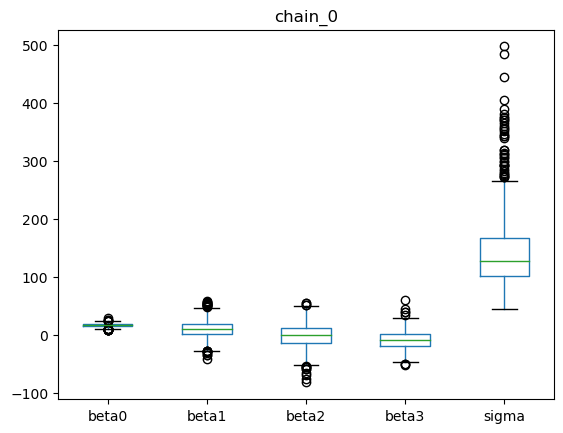

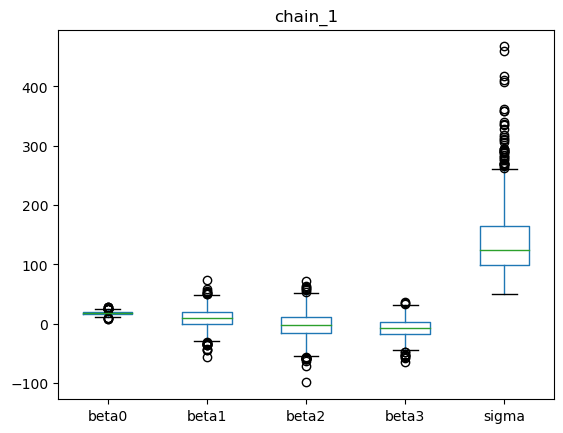

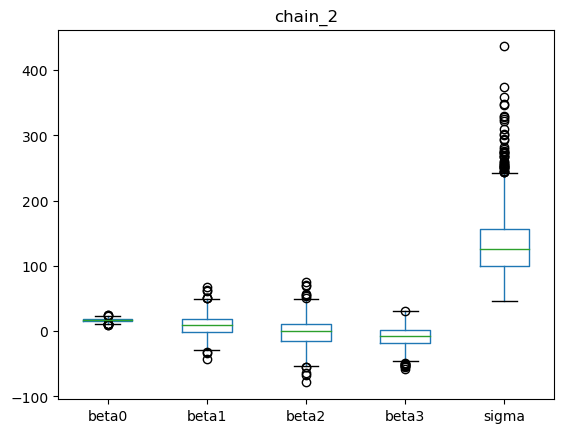

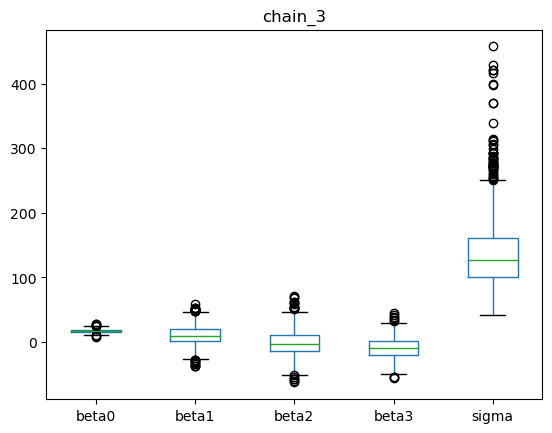

In [12]:
# # Use plot_interactive=True for plotly plots offline

# plot_parameters_for_n_chains(chains=['chain_0', 'chain_1', 'chain_2', 'chain_3'], parameters=parameters, plot_interactive=False)


###### A.4.2 Joint distribution plots
Following plots the `joint distribution` of `pair of each parameter` sampled values for all chains of model parameters.

In [281]:
# # @staticmethod
# def plot_joint_distribution(fit_df, parameters):
#     all_combination_params = list(itertools.combinations(parameters, 2))
#     for param_combo in all_combination_params:
#         param1, param2= param_combo
#         print("\nPyro -- %s"%(f'{param1} Vs. {param2}'))
#         sns.jointplot(data=fit_df, x=param1, y=param2, hue= "chain")
#         plt.title(f'{param1} Vs. {param2}')
#         plt.show()


Pyro -- beta0 Vs. beta2


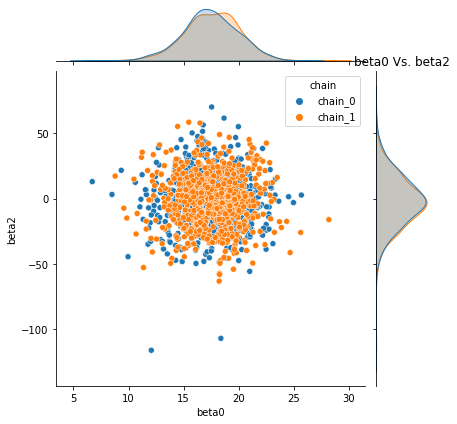


Pyro -- beta0 Vs. sigma


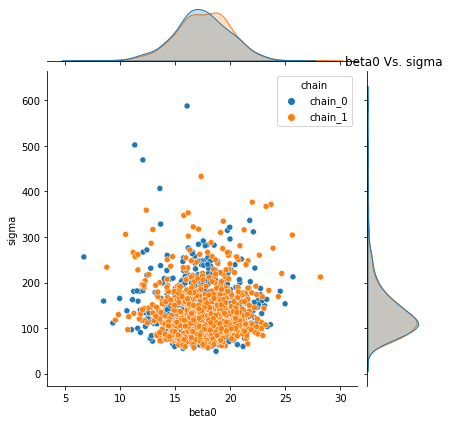


Pyro -- beta0 Vs. beta3


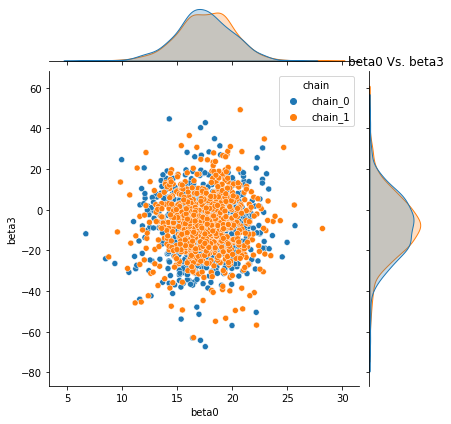


Pyro -- beta0 Vs. beta1


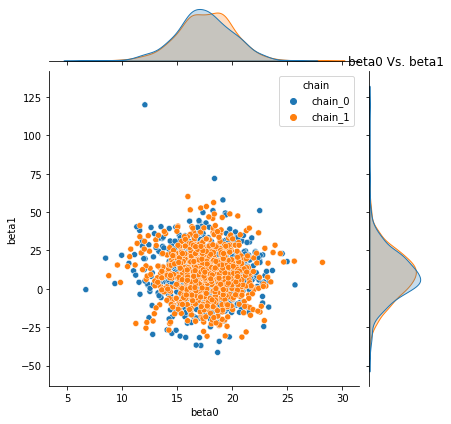


Pyro -- beta2 Vs. sigma


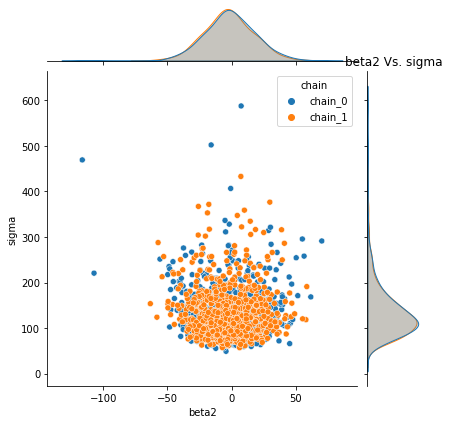


Pyro -- beta2 Vs. beta3


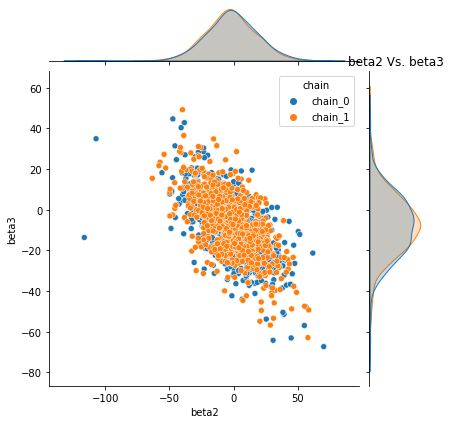


Pyro -- beta2 Vs. beta1


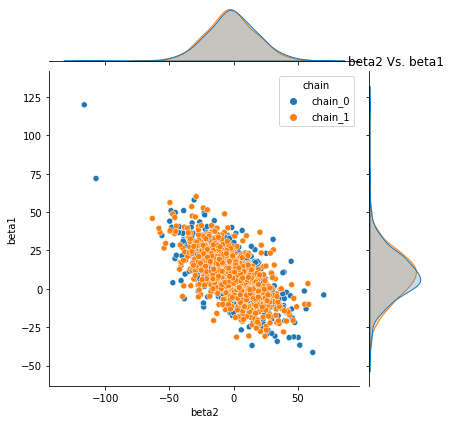


Pyro -- sigma Vs. beta3


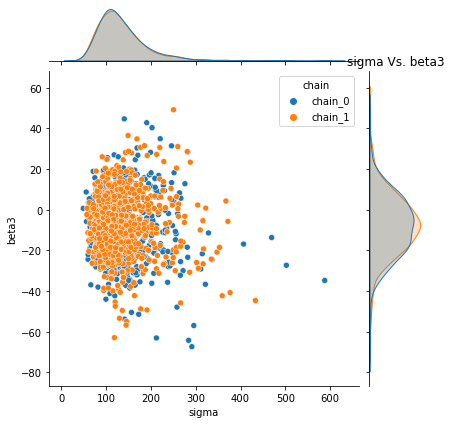


Pyro -- sigma Vs. beta1


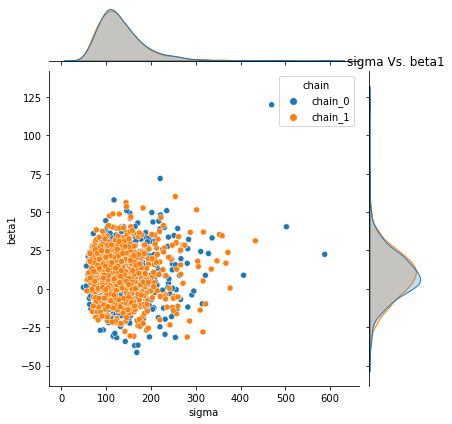


Pyro -- beta3 Vs. beta1


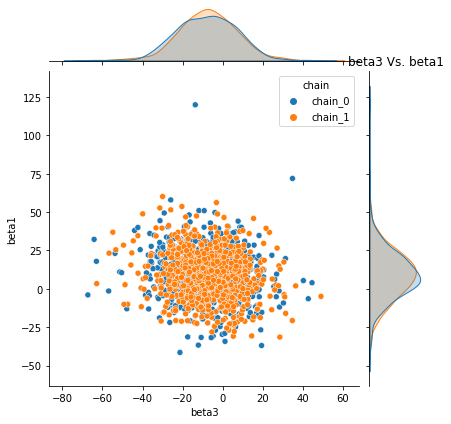

In [282]:

plot_joint_distribution(fit_df_A, parameters)
# base.plot_joint_distribution(fit_df_A, parameters)


###### A.4.3 Pairplots
Following plots the `Pairplot distribution` of each parameter with every other parameter's sampled values for all chains of model parameters.

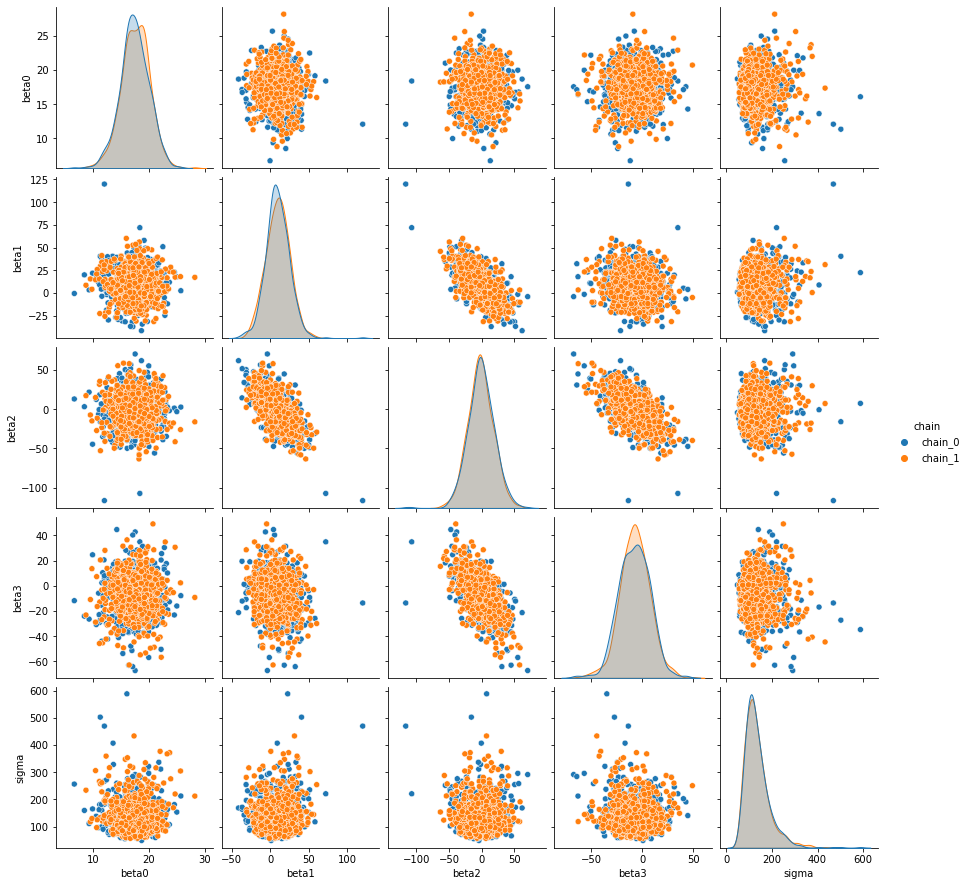

In [279]:
sns.pairplot(data=fit_df_A, hue= "chain");

#### KDE plots
Kernel density plots for models

In [283]:
chain_list= list(hmc_sample_chains_a[chain].values())
# chain_list.extend(list(hmc_sample_chains_b[chain].values()))

In [286]:
list(hmc_sample_chains_a[chain].keys())

['beta0', 'beta1', 'beta2', 'beta3', 'sigma']

In [288]:
import plotly
import plotly.express as px
import plotly.figure_factory as ff
for chain in hmc_sample_chains_a.keys():
    print("____\nFor model %s"%chain)
    chain_list= list(hmc_sample_chains_a[chain].values())
#     chain_list.extend(list(hmc_sample_chains_b[chain].values()))
    title= "parameter distribution for : %s"%(chain)
    fig = ff.create_distplot(chain_list, list(hmc_sample_chains_a[chain].keys()))
    fig.update_layout(title=title, xaxis_title="parameter values", yaxis_title="density", legend_title="parameters")
    fig.show()
    break

____
For model chain_0


### 6. Sensitivity Analysis

Posterior Predictive Checking (PoPC) helps examine the fit of a model to real data. The simulation parameters come from the posterior distribution. While `PoPC` incorporates model uncertainly (by averaring over all possible models), we take a simpler route to begin with, which is to sample all parameters' pairs that are very plausible in the posterior (eg. the posterior means), and simulate data under this particular generative model.

In [ ]:
# With priors & posteriros
posterior_parameters_pairs_a = pruned_hmc_sample_chains_a.get('chain_0')

# posterior_parameters_pairs_b = pruned_hmc_sample_chains_b.get('chain_0')

# original_plus_simulated_data_posterior, obs_y_with_original_data_df = base.simulate_observations_given_prior_posterior_pairs(Y, 
#                                                                                                                              prior_simulations=original_plus_simulated_data_prior, 
#                                                                                                                              model_normal_a= posterior_parameters_pairs_a)

original_plus_simulated_data_posterior, original_plus_simulated_data_df = simulate_observations_given_prior_posterior_pairs(Y, 
                                                                                                                        prior_simulations=original_plus_simulated_data_prior, 
                                                                                                                        model_normal_a= posterior_parameters_pairs_a)



In [ ]:
# original_plus_simulated_data_posterior_df= pd.DataFrame(original_plus_simulated_data_posterior.T, 
#                                                      columns=["Dog_%s"%(idx+1) for idx in range(len(original_plus_simulated_data_posterior))])


base.save_parameter_chain_dataframe(original_plus_simulated_data_df, 
                                    "data/dogs_original_plus_simulated_data_pyro_model.csv")

### 8. Inference & Analysis

Alright, we have a model, but so what? The purpose of model building is to use these models as probing devices. That is, using the models can we answer some questions about the reality that these models have abstracted. 

Plot density & contours for both parameters from `chain_0` to visualise the joint distribution & region of interest.

In [400]:
def plot_interaction_contours(fit_df, parameters=None, 
                              chain="chain_0", plot_3d=False):
    pair_count= 2
    if plot_3d:
        pair_count= 3
    
    chain_samples_df= fit_df[fit_df["chain"]==chain].copy()# chain is 'chain_3' 
    parameters= parameters if parameters else list(set(chain_samples_df.columns)- {"chain"})
    
    all_combination_params= list(itertools.combinations(parameters, pair_count))
    for param_combination in all_combination_params:
        param_combination= list(param_combination)
        print("\nFor parameters: '%s' & '%s'"%(param_combination, chain))
        chain_samples_df_slice= chain_samples_df[param_combination].values
        if plot_3d:
            name1, name2, name3 = param_combination
            fig = go.Figure(data=[go.Surface(z=chain_samples_df_slice)])
            fig.update_layout(title="3D Contour plot for '%s'"%(str(param_combination)), autosize=False,
                        xaxis_title="x (%s)"%name1, yaxis_title="y (%s)"%name2,
                        width=500, height=500, margin=dict(l=65, r=50, b=65, t=90))
        else:
            param1, param2 = chain_samples_df_slice.T
            name1, name2 = param_combination
            colorscale = ['#7A4579', '#D56073', 'rgb(236,158,105)', (1, 1, 0.2), (0.98,0.98,0.98)]
            fig = ff.create_2d_density(param1, param2, colorscale=colorscale, hist_color='rgb(255, 255, 150)', 
                point_size=4)
            fig.update_layout(title= "%s-%s joint density plot for model"%(name1, name2), autosize=False,
                              xaxis_title="x (%s)"%name1, yaxis_title="y (%s)"%name2)

        fig.show()
    

In [390]:
parameters= list(set(chain_samples_df_A.columns)- {"chain"})
parameters

['beta0', 'beta2', 'sigma', 'beta3', 'beta1']

In [404]:
# Optionally pass select list of parameters = ['beta0', 'beta2', 'sigma']
plot_interaction_contours(fit_df_A, plot_3d=True)


For parameters: '['beta0', 'beta2', 'sigma']' & 'chain_0'



For parameters: '['beta0', 'beta2', 'beta3']' & 'chain_0'



For parameters: '['beta0', 'beta2', 'beta1']' & 'chain_0'



For parameters: '['beta0', 'sigma', 'beta3']' & 'chain_0'



For parameters: '['beta0', 'sigma', 'beta1']' & 'chain_0'



For parameters: '['beta0', 'beta3', 'beta1']' & 'chain_0'



For parameters: '['beta2', 'sigma', 'beta3']' & 'chain_0'



For parameters: '['beta2', 'sigma', 'beta1']' & 'chain_0'



For parameters: '['beta2', 'beta3', 'beta1']' & 'chain_0'



For parameters: '['sigma', 'beta3', 'beta1']' & 'chain_0'


In [403]:
# import itertools
# plot_3d= True#False# 
# chain_samples_df_A= fit_df_A[fit_df_A["chain"]==chain].copy()# chain is 'chain_3' 

# pair_count= 2
# if plot_3d:
#     pair_count= 3

# all_combination_params= list(itertools.combinations(parameters, pair_count))
# for param_combination in all_combination_params:
#     param_combination= list(param_combination)
#     print("\nFor parameters: '%s' & '%s'"%(param_combination, chain))
#     chain_samples_df_slice= chain_samples_df_A[param_combination].values
#     if plot_3d:
#         name1, name2, name3 = param_combination
#         fig = go.Figure(data=[go.Surface(z=chain_samples_df_slice)])
#         fig.update_layout(title="Contour plot for paramters '%s'"%(param_combination), autosize=False,
#                     xaxis_title="x (%s)"%name1, yaxis_title="y (%s)"%name2,
#                     width=500, height=500, margin=dict(l=65, r=50, b=65, t=90))
#     else:
#         param1, param2 = chain_samples_df_slice.T
#         name1, name2 = param_combination
#         colorscale = ['#7A4579', '#D56073', 'rgb(236,158,105)', (1, 1, 0.2), (0.98,0.98,0.98)]
#         fig = ff.create_2d_density(param1, param2, colorscale=colorscale, hist_color='rgb(255, 255, 150)', 
#             point_size=4, title= "%s-%s joint density plot for model"%(name1, name2))
#         fig.update_layout(title="Contour plot for paramters '%s'"%(param_combination), autosize=False,
#                           xaxis_title="x (%s)"%name1, yaxis_title="y (%s)"%name2)

#     fig.show()

### B. Pystan modelling
Pystan model for model comparison

In [406]:
import pystan as ps
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import pandas as pd
from plotly.subplots import make_subplots
# pd.options.plotting.backend = "plotly"


stacks_code = """
data {
  int<lower=0> N;
  int<lower=0> p;
  real Y[N];
  matrix[N,p] x;
} 

// to standardize the x's 
transformed data {
  matrix[N,p] z;
  row_vector[p] mean_x;
  real sd_x[p];
  for (j in 1:p) { 
    mean_x[j] <- mean(col(x,j)); 
    sd_x[j] <- sd(col(x,j)); 
    for (i in 1:N)  
      z[i,j] <- (x[i,j] - mean_x[j]) / sd_x[j]; 
  }
}

parameters {
  real beta0; 
  vector[p] beta; 
  real<lower=0> sigmasq; 
} 

transformed parameters {
  real<lower=0> sigma;
  vector[N] mu;
  sigma <- sqrt(sigmasq);
  mu <- beta0 + z * beta;
}

model {
  beta0 ~ normal(0, 316); 
  beta ~ normal(0, 316); 
  sigmasq ~ inv_gamma(.001, .001);
  Y ~ normal(mu, sigma);
} 

generated quantities {
  real b0;
  vector[p] b;
  real outlier_3;
  real outlier_4;
  real outlier_21;

  for (j in 1:p)
    b[j] <- beta[j] / sd_x[j];
  b0 <- beta0 - mean_x * b;

  outlier_3  <- step(fabs((Y[3] - mu[3]) / sigma) - 2.5);
  outlier_4  <- step(fabs((Y[4] - mu[4]) / sigma) - 2.5);
  outlier_21 <- step(fabs((Y[21] - mu[21]) / sigma) - 2.5);
}
"""

stacks_data = {"p":3, "N":21, "Y":[43, 37, 37, 28, 18, 18, 19, 20, 15, 14, 14, 13, 11, 12, 8, 
7, 8, 8, 9, 15, 15], "x":np.array([80, 80, 75, 62, 62, 62, 62, 62, 59, 58, 58, 58, 58, 
58, 50, 50, 50, 50, 50, 56, 70, 27, 27, 25, 24, 22, 23, 24, 24, 
23, 18, 18, 17, 18, 19, 18, 18, 19, 19, 20, 20, 20, 89, 88, 90, 
87, 87, 87, 93, 93, 87, 80, 89, 88, 82, 93, 89, 86, 72, 79, 80, 
82, 91]).reshape((21,3))}

In [18]:
posterior = ps.StanModel(model_code=stacks_code)#, data=schools_data, random_seed=1)
fit = posterior.sampling(data=stacks_data, iter=1000, chains=4, seed=1)

INFO:pystan:COMPILING THE C++ CODE FOR MODEL anon_model_3e0eded9705315cb92017c5ad079b544 NOW.


In [29]:
print(fit)

Inference for Stan model: anon_model_3e0eded9705315cb92017c5ad079b544.
4 chains, each with iter=1000; warmup=500; thin=1; 
post-warmup draws per chain=500, total post-warmup draws=2000.

             mean se_mean     sd   2.5%    25%    50%    75%  97.5%  n_eff   Rhat
beta0       17.52    0.06   2.51  12.46  15.95  17.54  19.15  22.31   1734    1.0
beta[1]     10.63    0.45  14.78 -17.47   0.52  10.39  20.13  40.77   1096    1.0
beta[2]     -2.01    0.64  19.51 -41.29 -14.55   -2.7  11.06  37.73    935    1.0
beta[3]     -8.49    0.47  14.65 -37.19 -17.68  -9.16   1.02  20.01    988    1.0
sigmasq    134.15    1.77  52.33  67.66  97.02 122.73 156.08 259.31    878    1.0
sigma       11.39    0.07   2.09   8.23   9.85  11.08  12.49   16.1    935    1.0
mu[1]       19.62    0.12   4.42   10.6  16.76  19.57  22.41  28.19   1414    1.0
mu[2]       17.86    0.06    2.6  12.52  16.22  17.82  19.54  22.93   1642    1.0
mu[3]       18.75    0.08   3.12  12.24  16.79  18.75  20.77  24.79   1483 

In [61]:
params_pystan= fit.extract()
params_pystan

OrderedDict([('beta0',
              array([18.4674982 , 20.9569108 , 19.40835325, ..., 18.08549742,
                     16.48787943, 16.51161674])),
             ('beta', array([[-11.81028733,  14.39751803,  -1.95369233],
                     [  8.03125587,  -5.31946233,  -5.170025  ],
                     [ 46.16845001, -34.93013092, -12.72308535],
                     ...,
                     [ -6.48131152,  21.60708789, -12.53271005],
                     [ 22.47763628, -23.67534644,   4.10612246],
                     [ -4.60801019,  21.69814434, -15.51879342]])),
             ('sigmasq',
              array([123.61848214, 106.59748736, 166.85860894, ...,  72.93862461,
                     151.24362851, 142.94254906])),
             ('sigma',
              array([11.11838487, 10.32460592, 12.91737624, ...,  8.54041127,
                     12.29811484, 11.95585836])),
             ('mu',
              array([[18.93103672, 18.3011084 , 18.50584078, ..., 23.7549901 ,
             

In [22]:
fit_df_pystan= fit.to_dataframe()
# fit_df_pystan.to_csv("data/stack_regression_hmc_samples[pystan].csv", index=False)
fit_df_pystan

,chain,draw,warmup,beta0,beta[1],beta[2],beta[3],sigmasq,sigma,mu[1],...,outlier_3,outlier_4,outlier_21,lp__,accept_stat__,stepsize__,treedepth__,n_leapfrog__,divergent__,energy__
0,0,0,0,18.928377,3.155693,-2.190858,-4.371486,121.684728,11.031080,16.989106,...,0.0,0.0,0.0,-60.020297,0.770160,0.072835,4,27,0,62.718299
1,0,1,0,18.568419,8.092747,8.623133,-18.964355,71.151562,8.435139,20.537808,...,0.0,0.0,0.0,-60.343891,0.981741,0.072835,5,31,0,61.407529
2,0,2,0,16.428101,24.290694,-33.413709,8.423697,151.920084,12.325587,15.155982,...,0.0,0.0,0.0,-60.658132,0.985818,0.072835,6,63,0,62.314234
3,0,3,0,17.070876,-0.312046,-7.598830,6.574173,120.108512,10.959403,14.692378,...,0.0,0.0,0.0,-59.660293,0.949237,0.072835,6,63,0,62.096187
4,0,4,0,16.028532,-3.098011,-5.068651,6.492513,105.361024,10.264552,13.276498,...,0.0,0.0,0.0,-60.037600,0.987064,0.072835,5,63,0,60.431712
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,3,495,0,16.952399,8.258991,25.048287,-37.674257,165.547837,12.866539,20.658131,...,0.0,0.0,0.0,-62.338117,0.934744,0.095552,5,31,0,62.886475
1996,3,496,0,18.441020,1.885997,24.017403,-27.422503,121.167232,11.007599,22.387479,...,0.0,0.0,0.0,-60.080147,0.970496,0.095552,5,31,0,62.811395
1997,3,497,0,19.290214,-8.942330,26.727451,-18.025183,67.672967,8.226358,22.146370,...,0.0,0.0,0.0,-61.809377,0.995654,0.095552,5,31,0,63.364392
1998,3,498,0,19.100227,-9.693598,27.820101,-17.347120,66.384168,8.147648,22.662469,...,0.0,0.0,0.0,-62.104940,0.885800,0.095552,5,31,0,62.617802


In [410]:

base.save_parameter_chain_dataframe(fit_df_pystan, "data/stack_regression_hmc_samples[pystan].csv")


In [ ]:
# Use following to load data once the results from pyro sampling operation are saved offline
load_button= base.build_upload_button()

In [ ]:
# Use following to load data once the results from pyro sampling operation are saved offline

if load_button.value:
    fit_df_pystan = base.load_parameter_chain_dataframe(load_button)#Load "data/stack_regression_hmc_samples[pystan].csv"


In [494]:
# Use following once the results from Pystan sampling operation are saved offline

fit_df_pystan= pd.read_csv("data/stack_regression_hmc_samples[pystan].csv")
fit_df_pystan.head(3)

,chain,draw,warmup,beta0,beta[1],beta[2],beta[3],sigmasq,sigma,mu[1],...,outlier_3,outlier_4,outlier_21,lp__,accept_stat__,stepsize__,treedepth__,n_leapfrog__,divergent__,energy__
0,0,0,0,18.928377,3.155693,-2.190858,-4.371486,121.684728,11.031080,16.989106,...,0.0,0.0,0.0,-60.020297,0.770160,0.072835,4,27,0,62.718299
1,0,1,0,18.568419,8.092747,8.623133,-18.964355,71.151562,8.435139,20.537808,...,0.0,0.0,0.0,-60.343891,0.981741,0.072835,5,31,0,61.407529
2,0,2,0,16.428101,24.290694,-33.413709,8.423697,151.920084,12.325587,15.155982,...,0.0,0.0,0.0,-60.658132,0.985818,0.072835,6,63,0,62.314234


In [495]:
import re
from difflib import SequenceMatcher
def output_similar(param1, param2):
    result = SequenceMatcher(None, param1, param2).ratio()
    if result>0.8: return param2
    
def map_columns(param1, rel_columns):
    result= list(filter(lambda param2: output_similar(param1, param2), rel_columns))
    if result: return (result[0], param1)


regsample = re.compile(r'sigma$|beta[ ]?|chain')
relevant_pystan_columns = list(filter(regsample.search, list(fit_df_pystan.columns)))

pyro_pystan_cols_dict = dict(list(map(lambda pyro_param: map_columns(pyro_param, relevant_pystan_columns), parameters)))
print("Relevant pystan columns: ", relevant_pystan_columns, "\n\nPyro to pystan colummn map: ",pyro_pystan_cols_dict)

Relevant pystan columns:  ['chain', 'beta0', 'beta[1]', 'beta[2]', 'beta[3]', 'sigma'] 

Pyro to pystan colummn map:  {'beta[1]': 'beta1', 'beta[3]': 'beta3', 'sigma': 'sigma', 'beta[2]': 'beta2', 'beta0': 'beta0'}


In [496]:
fit_df_B = fit_df_pystan[relevant_pystan_columns].copy()
fit_df_B["chain"] = fit_df_B["chain"].apply(lambda x:"chain_%s"%x)
fit_df_B.rename(columns=pyro_pystan_cols_dict, inplace=True)

base.save_parameter_chain_dataframe(fit_df_B, "data/stack_regression_hmc_samples[pystan_formatted].csv")


,chain,beta0,beta1,beta2,beta3,sigma
0,chain_0,18.928377,3.155693,-2.190858,-4.371486,11.031080
1,chain_0,18.568419,8.092747,8.623133,-18.964355,8.435139
2,chain_0,16.428101,24.290694,-33.413709,8.423697,12.325587
3,chain_0,17.070876,-0.312046,-7.598830,6.574173,10.959403
4,chain_0,16.028532,-3.098011,-5.068651,6.492513,10.264552
...,...,...,...,...,...,...
1995,chain_3,16.952399,8.258991,25.048287,-37.674257,12.866539
1996,chain_3,18.441020,1.885997,24.017403,-27.422503,11.007599
1997,chain_3,19.290214,-8.942330,26.727451,-18.025183,8.226358
1998,chain_3,19.100227,-9.693598,27.820101,-17.347120,8.147648


###### B Summary Table
5-point Summary Statistics for Pystan model chains.

Following outputs the similar summary of required statistics such as `"mean", "std", "Q(0.25)", "Q(0.50)", "Q(0.75)"`, but in a slightly different format, given a list of statistic names

In [638]:
# Pass any or All of the metric values as list, to view posterior summary
key_metrics= ["mean", "std", "25%", "50%", "75%"]

summary_stats_df_2(fit_df_B, key_metrics)
base.summary_stats_df_2(fit_df_B, key_metrics)

mean        std        25%        50%        75%
parameter chain                                                         
beta0     chain_0  17.571099   2.605869  15.816209  17.543887  19.329250
          chain_1  17.575962   2.575488  16.022127  17.697151  19.206536
          chain_2  17.438131   2.585339  15.834982  17.447945  19.201057
          chain_3  17.488556   2.265300  16.055608  17.486719  18.901170
beta2     chain_0  -3.471325  19.784070 -15.716704  -3.257380  10.650848
          chain_1  -2.064484  20.066303 -15.201950  -2.438730  10.997859
          chain_2  -1.024488  19.811979 -12.139112  -2.267048  11.431169
          chain_3  -1.479858  18.279741 -13.180875  -2.478856  11.111396
sigma     chain_0  11.400578   2.150765   9.867497  11.033386  12.482435
          chain_1  11.485451   2.065889   9.887893  11.245564  12.760556
          chain_2  11.423169   2.008234   9.868084  11.108659  12.583079
          chain_3  11.260700   2.128857   9.787770  10.900446  12.218846
beta3     chain_0  -7.408327  15.426092 -17.112597  -7.785987   2.352674
          chain_1  -8.596175  15.746260 -18.154305  -9.713069   1.001033
          chain_2  -8.375658  13.977804 -17.215732  -8.970723   1.377498
          chain_3  -9.579874  13.260106 -17.613307  -9.552650  -0.770513
beta1     chain_0  11.037135  15.267408   0.170137  10.841768  21.652315
          chain_1  10.890145  14.611592   0.691986  11.551165  20.636765
          chain_2   9.469683  14.631706   0.285248   8.651789  17.795402
          chain_3  11.104806  14.595227   0.955593  10.605308  20.736721

##### B Additional plots

###### B.1 Boxplots
Boxplot for Pystanmodel chains

In [641]:
plot_parameters_for_n_chains(fit_df_B, chains=['chain_0', 'chain_1', 'chain_2', 'chain_3'], parameters=parameters, plot_interactive=True)

# base.plot_parameters_for_n_chains(fit_df_B, chains=['chain_0', 'chain_1', 'chain_2', 'chain_3'], parameters=parameters, plot_interactive=True)

In [23]:
# parameters_pystan= ["beta0", "beta[1]", "beta[2]", "beta[3]"]# All parameters for given model
# chains_pystan= fit_df_pystan["chain"].unique()# Number of chains sampled for given model


# func_all_params_per_chain_pystan = lambda param, chain: (param, fit_df_pystan[fit_df_pystan["chain"]==chain][param].tolist())
# func_all_chains_per_param_pystan = lambda chain, param: (f'Chain_{chain}', fit_df_pystan[param][fit_df_pystan["chain"]==chain].tolist())

# di_all_params_per_chain_pystan = dict(map(lambda param: func_all_params_per_chain_pystan(param, 0), parameters_pystan))
# di_all_chains_per_param_pystan = dict(map(lambda chain: func_all_chains_per_param_pystan(chain, "beta0"), chains_pystan))

In [ ]:

# plot_chains_for_n_parameters_pystan(parameters=["beta0", "beta[1]", "beta[2]", "beta[3]"], chains=[0, 1, 3, 2], plot_interactive=False)



In [24]:

# def plot_parameters_for_n_chains_pystan(chains=[0], parameters=["beta0", "beta[1]", "beta[2]", "beta[3]"], plotting_cap=[4, 4], plot_interactive=False):
#     try:
#         chain_cap, param_cap = plotting_cap#
#         assert len(chains)<=chain_cap, "Cannot plot Number of chains greater than %s!"%chain_cap
#         assert len(parameters)<=param_cap, "Cannot plot Number of parameters greater than %s!"%param_cap
        
#         for chain in chains:
#             di_all_params_per_chain = dict(map(lambda param: func_all_params_per_chain_pystan(param, chain), parameters))
#             df_all_params_per_chain = pd.DataFrame(di_all_params_per_chain)
#             if df_all_params_per_chain.empty:
# #                 raise Exception("Invalid chain number in context of model!")
#                 print("Note: Chain number [%s] is Invalid in context of this model!"%chain)
#                 continue

#             if plot_interactive:
#               df_all_params_per_chain= df_all_params_per_chain.unstack().reset_index(level=0)
#               df_all_params_per_chain.rename(columns={"level_0":"parameters", 0:"values"}, inplace=True)
#               fig = px.box(df_all_params_per_chain, x="parameters", y="values")
#               fig.update_layout(height=600, width=900, title_text=f'chain_{chain}')
#               fig.show()
#             else:
#               df_all_params_per_chain.plot.box()
#               plt.title(f'chain_{chain}')

#     except Exception as error:
#         if type(error) is AssertionError:
#             print("Note: %s"%error)
#             chains = np.random.choice(chains, chain_cap, replace=False)
#             parameters=np.random.choice(parameters, param_cap, replace=False)
#             plot_parameters_for_n_chains(chains, parameters)
#         else: print("Error: %s"%error)


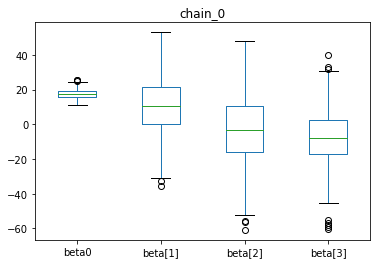

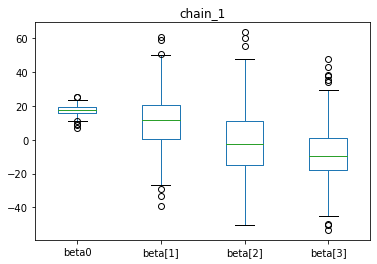

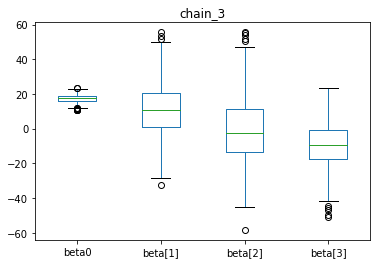

In [25]:
# # Use plot_interactive=True for plotly plots offline

# plot_parameters_for_n_chains_pystan(chains=[0, 1, 3], parameters=["beta0", "beta[1]", "beta[2]", "beta[3]"], plot_interactive=False)


**Following Plots n chains side by side for m parameters**

In [642]:
# def plot_chains_for_n_parameters_pystan(parameters=["beta0", "beta[1]", "beta[2]", "beta[3]"], chains=[0,1,2,3,4], plotting_cap=[4, 4], plot_interactive=False):
#     screen_invalid_chains = lambda chain_val: True if not chain_val[1] else False# Filters Invalid chain results
#     screen_valid_chain_results = lambda chain_val: True if chain_val[1] else False# Filters valid chain results
#     try:
#         chain_cap, param_cap = plotting_cap#
#         assert len(chains)<=chain_cap, "Cannot plot Number of chains greater than %s!"%chain_cap
#         assert len(parameters)<=param_cap, "Cannot plot Number of parameters greater than %s!"%param_cap
        
#         for param in parameters:
# #             di_all_params_per_chain = dict(map(lambda param: func_all_params_per_chain(param, chain), parameters))
            
#             di_all_chains_per_param = dict(map(lambda chain: func_all_chains_per_param_pystan(chain, param), chains))

#             invalid_chains = dict(filter(screen_invalid_chains, list(di_all_chains_per_param.items())))
            
#             valid_chain_results = dict(filter(screen_valid_chain_results, list(di_all_chains_per_param.items())))
            
#             df_all_chains_per_param = pd.DataFrame(valid_chain_results)

            
#             if plot_interactive:
#               df_all_chains_per_param= df_all_chains_per_param.unstack().reset_index(level=0)
#               df_all_chains_per_param.rename(columns={"level_0":"chains", 0:"values"}, inplace=True)
#               fig = px.box(df_all_chains_per_param, x="chains", y="values")
#               fig.update_layout(height=600, width=900, title_text=f'parameter: {param}')
#               fig.show()
#             else:
#               df_all_chains_per_param.plot.box()
#               plt.title(f'parameter: {param}')
            
#             # fig= df_all_chains_per_param.plot.box()# Uncomment if pandas backend is set to "plotly"
#             # fig.update_layout(height=600, width=900, title_text=f'parameter: {param}')
#             # fig.show()
#             if invalid_chains:
#                 print("Note: Chain numbers %s are Invalid in context of this model!"%list(invalid_chains.keys()))
#     except Exception as error:
#         if type(error) is AssertionError:
#             print("Note: %s"%error)
#             chains = np.random.choice(chains, chain_cap, replace=False)
#             parameters=np.random.choice(parameters, param_cap, replace=False)
#             plot_chains_for_n_parameters(parameters, chains)
#         else: print("Error: %s"%error)

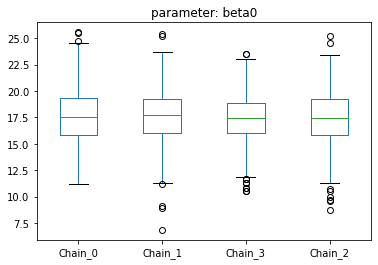

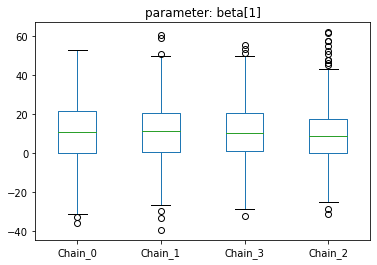

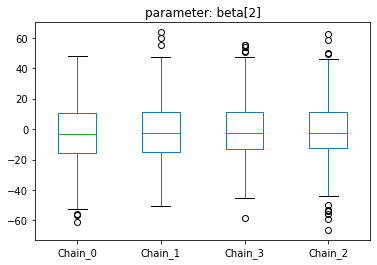

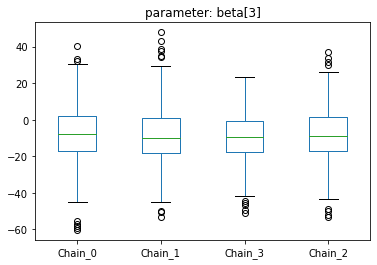

In [27]:
# # Use plot_interactive=True for plotly plots offline


# plot_chains_for_n_parameters_pystan(parameters=["beta0", "beta[1]", "beta[2]", "beta[3]"], chains=[0, 1, 3, 2], plot_interactive=False)


In [28]:
# Uncomment following to view plotly plots offline

# di_all_chains_per_param_pystan = dict(map(lambda chain: func_all_chains_per_param_pystan(chain, param), chains_pystan))

# df_all_chains_per_param_pystan = pd.DataFrame(di_all_chains_per_param_pystan)
# df_all_chains_per_param_sqeezed_pystan = df_all_chains_per_param_pystan.melt(value_name='posterior').rename(columns={"variable":"chains"})

# fig_2 = px.box(df_all_chains_per_param_sqeezed_pystan, x="chains", y="posterior", points="all")
# fig_2.show()

In [95]:
# fit_df_pystan_trunc = fit_df_pystan[['chain', 'beta0', 'beta[1]', 'beta[2]', 'beta[3]', 'sigma']].copy()
# fit_df_pystan_trunc["chain"]=fit_df_pystan_trunc["chain"].apply(lambda x: f'chain_{x}')
# fit_df_pystan_trunc.head(3)

,chain,beta0,beta[1],beta[2],beta[3],sigma
0,chain_0,18.928377,3.155693,-2.190858,-4.371486,11.031080
1,chain_0,18.568419,8.092747,8.623133,-18.964355,8.435139
2,chain_0,16.428101,24.290694,-33.413709,8.423697,12.325587


###### B.2 Joint distribution plots
Following plots the `joint distribution` of `pair of each parameter` sampled values for all chains with Pystan model.


Pyro -- beta0 Vs. beta2


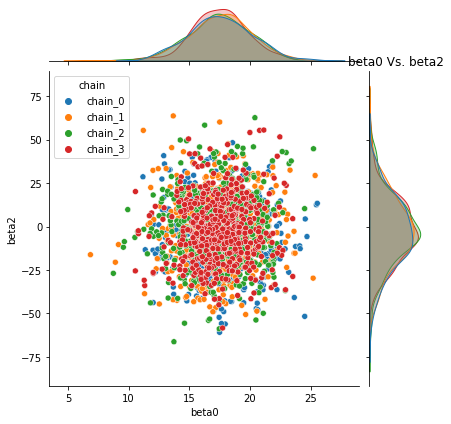


Pyro -- beta0 Vs. sigma


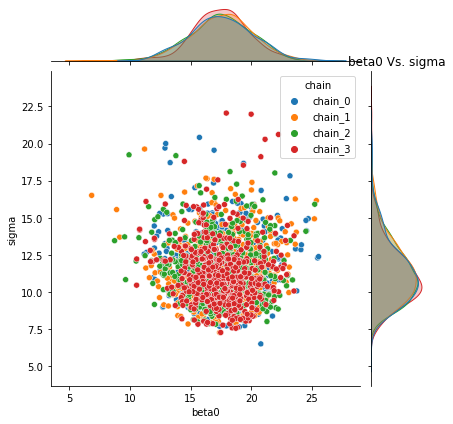


Pyro -- beta0 Vs. beta3


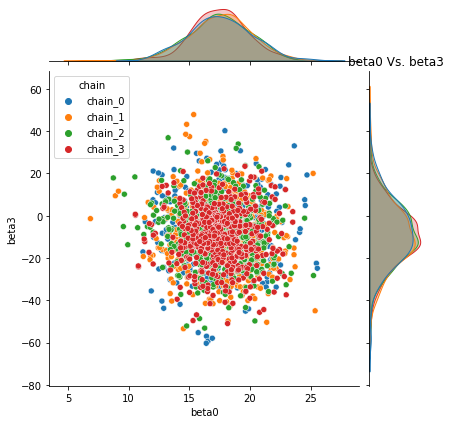


Pyro -- beta0 Vs. beta1


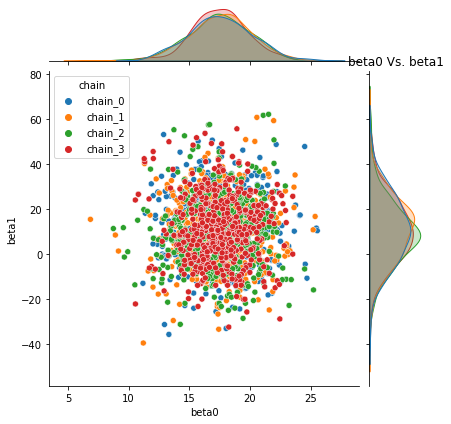


Pyro -- beta2 Vs. sigma


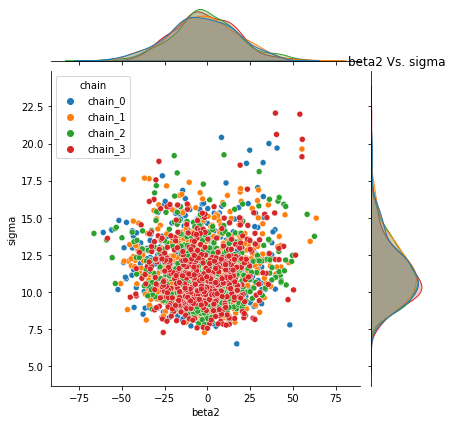


Pyro -- beta2 Vs. beta3


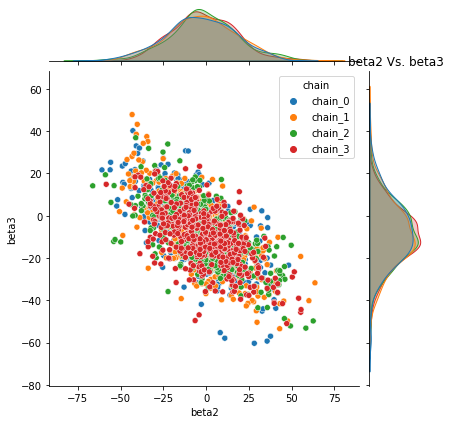


Pyro -- beta2 Vs. beta1


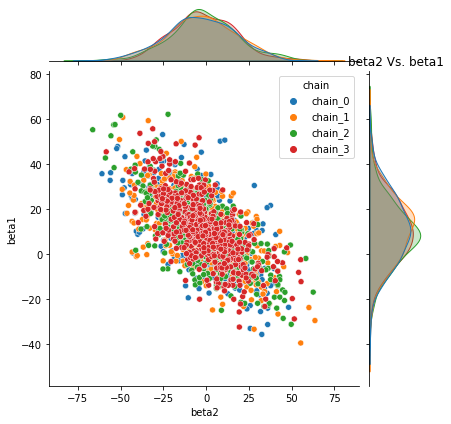


Pyro -- sigma Vs. beta3


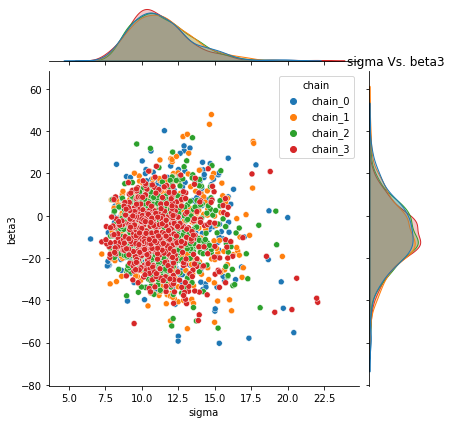


Pyro -- sigma Vs. beta1


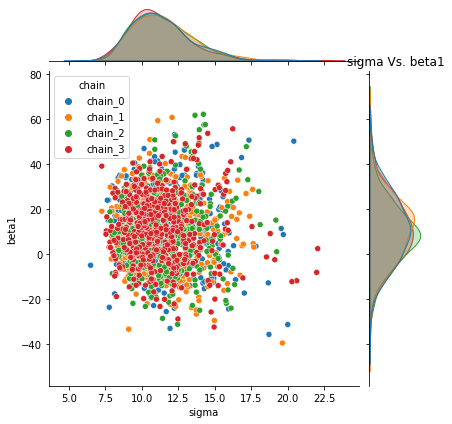


Pyro -- beta3 Vs. beta1


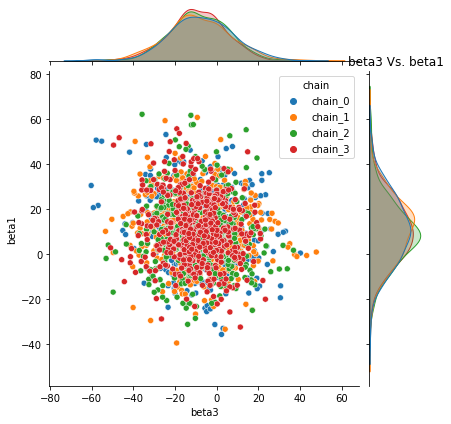

In [645]:
plot_joint_distribution(fit_df_B, parameters)
# base.plot_joint_distribution(fit_df_B, parameters)


###### B.3 Pairplots
Following plots the `Pairplot distribution` of each parameter with every other parameter's sampled values for all chains with Pystan model.

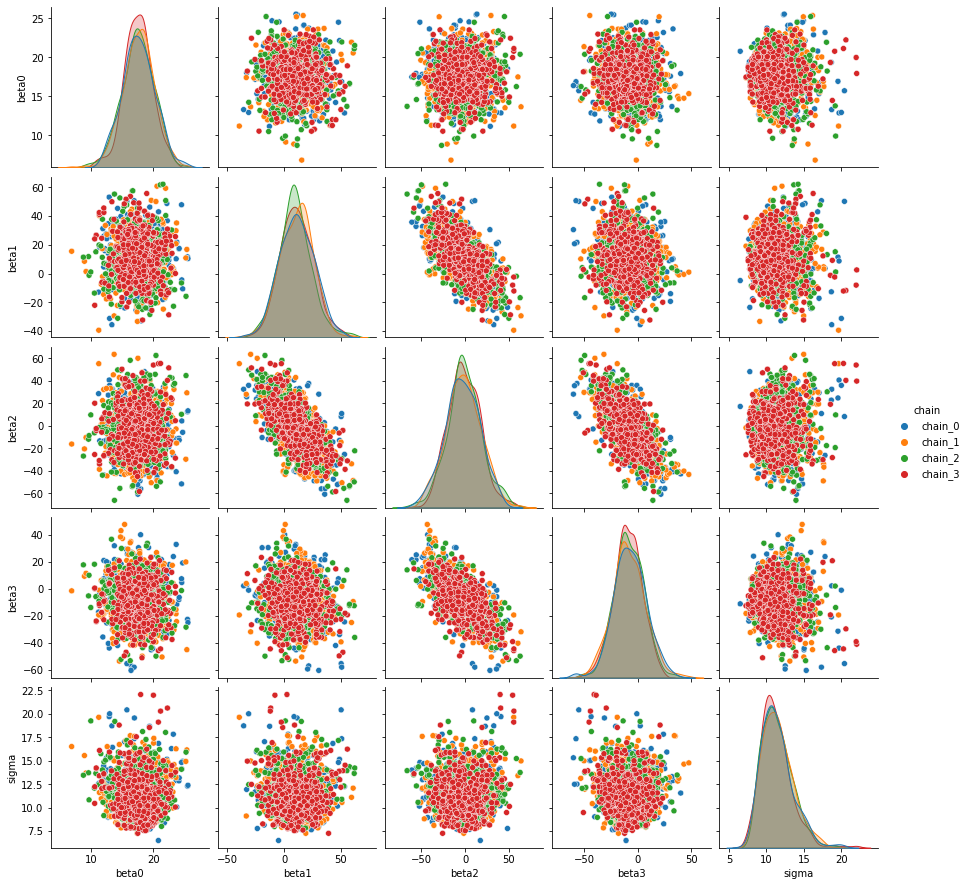

In [646]:
sns.pairplot(data=fit_df_B, hue= "chain");

### 7. Model Comparison
#### Chain intermixing plots
Plotting Intermixing of Chains from `Pyro` & `Pystan`

In [508]:
# import matplotlib.pyplot as plt
# import seaborn as sns

# def pyro_pystan_chain_intermixing(fit_df_A, fit_df_B):
#     sns.set_style("darkgrid")

#     all_params_chains_df = pd.DataFrame()
#     parameters = list(set(fit_df_A.columns)- {"chain"})# All params names
#     chains_pyro_pystan = list(fit_df_A["chain"].unique())# All chain_names

#     for param in parameters:
#         fig= plt.figure(figsize=(10,10))
#         all_chains_df= pd.DataFrame()
#         print("\nFor pyro_parameter: %s & pystan_parameter: %s"%(param, param))
#         for chain in chains_pyro_pystan:
#             all_chains_df_a = pd.DataFrame({"chain":"pyro_%s"%chain,
#                                            param:fit_df_A[fit_df_A["chain"]==chain][param].tolist()})
#             plt.plot(fit_df_A[fit_df_A["chain"]==chain][param], label="pyro_%s"%chain)

#             all_chains_df_b = pd.DataFrame({"chain":"pystan_%s"%chain,
#                                            param:fit_df_B[fit_df_B["chain"]==chain][param].tolist()})
#             plt.plot(fit_df_B[fit_df_B["chain"]==chain][param], label="pystan_%s"%chain)# Plots pystan chain
#             all_chains_df =pd.concat([all_chains_df, all_chains_df_a, all_chains_df_b], axis=0)
#         all_params_chains_df= pd.concat([all_params_chains_df, all_chains_df], axis=1)

#         plt.legend()
#         plt.title("Sampled values for %s"%(param))
#         plt.show()

#     return all_params_chains_df



For pyro_parameter: beta1 & pystan_parameter: beta1


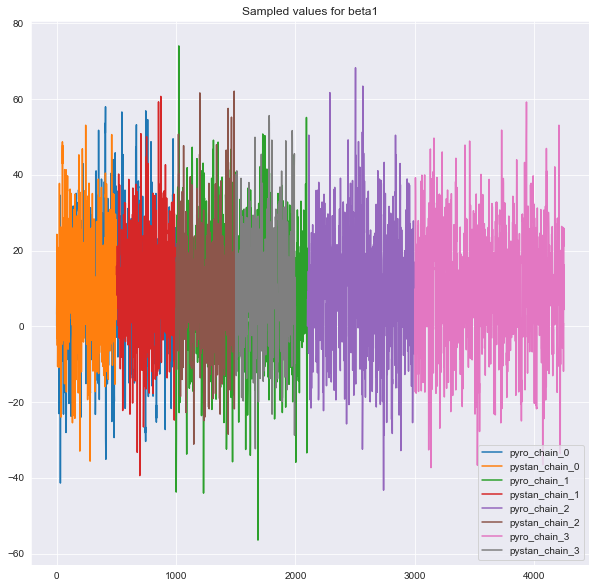


For pyro_parameter: beta3 & pystan_parameter: beta3


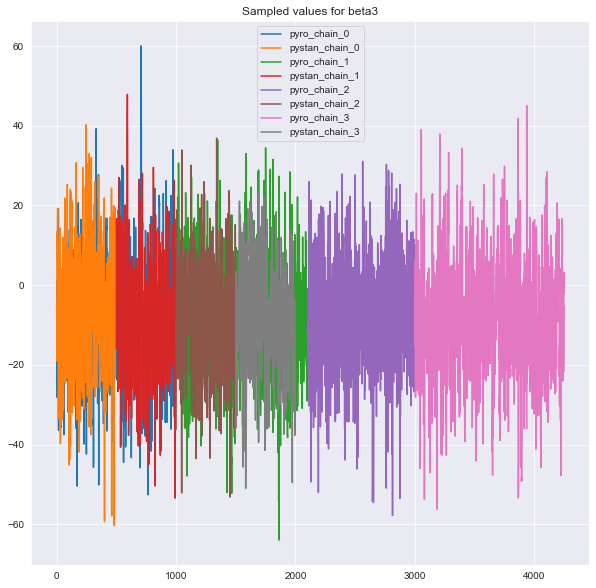


For pyro_parameter: sigma & pystan_parameter: sigma


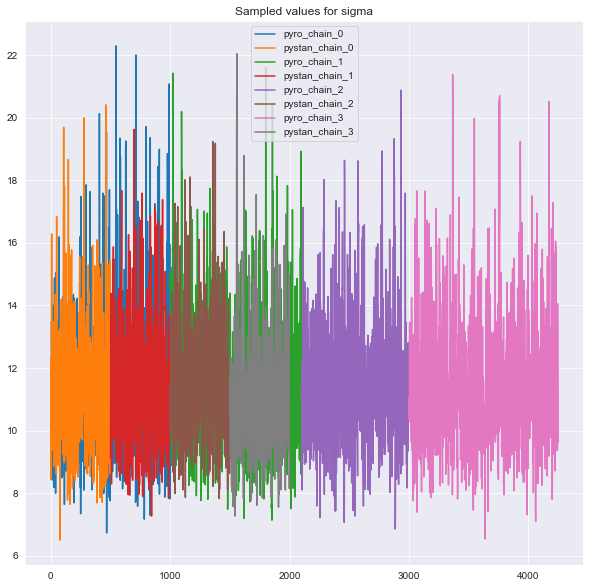


For pyro_parameter: beta2 & pystan_parameter: beta2


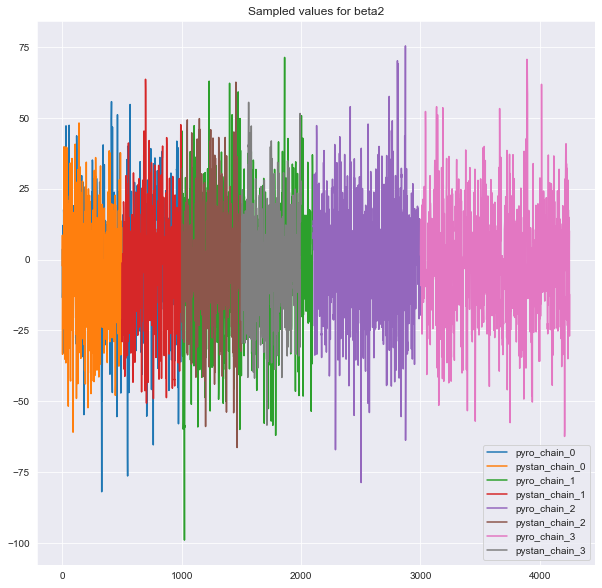


For pyro_parameter: beta0 & pystan_parameter: beta0


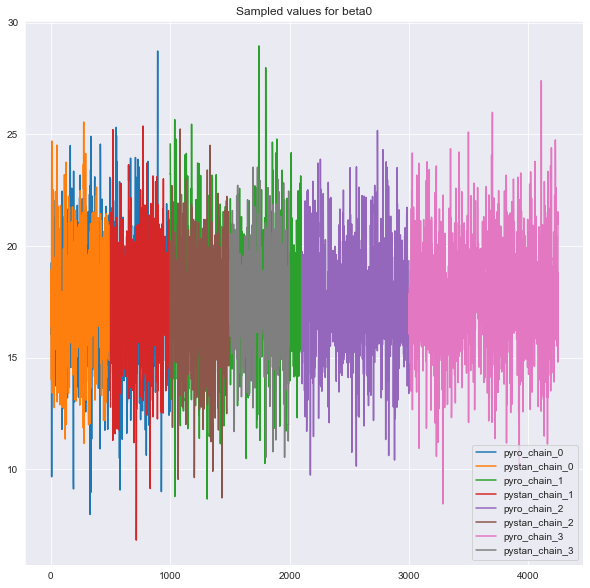

In [509]:
# pyro_pystan_intermixing_chains_df = pyro_pystan_chain_intermixing(fit_df_A, fit_df_B)

base.pyro_pystan_intermixing_chains_df = pyro_pystan_chain_intermixing(fit_df_A, fit_df_B)

In [511]:
pyro_pystan_intermixing_chains_df = pyro_pystan_intermixing_chains_df.loc[:,~pyro_pystan_intermixing_chains_df.columns.duplicated()]
pyro_pystan_intermixing_chains_df.head(3)

,chain,beta1,beta3,sigma,beta2,beta0
0,pyro_chain_0,-0.093745,-6.420473,9.125474,3.664827,18.716140
1,pyro_chain_0,14.835045,-2.179639,9.378535,-13.366175,16.050137
2,pyro_chain_0,12.376676,-0.115782,10.479008,-13.435370,17.946217


#### Pairplot comparison between pyro & pystan samples
Pairplot distribution of each parameter with every other parameter's sampled values
* Note: resulting density plots are from chains from both pyro & pystan sampling

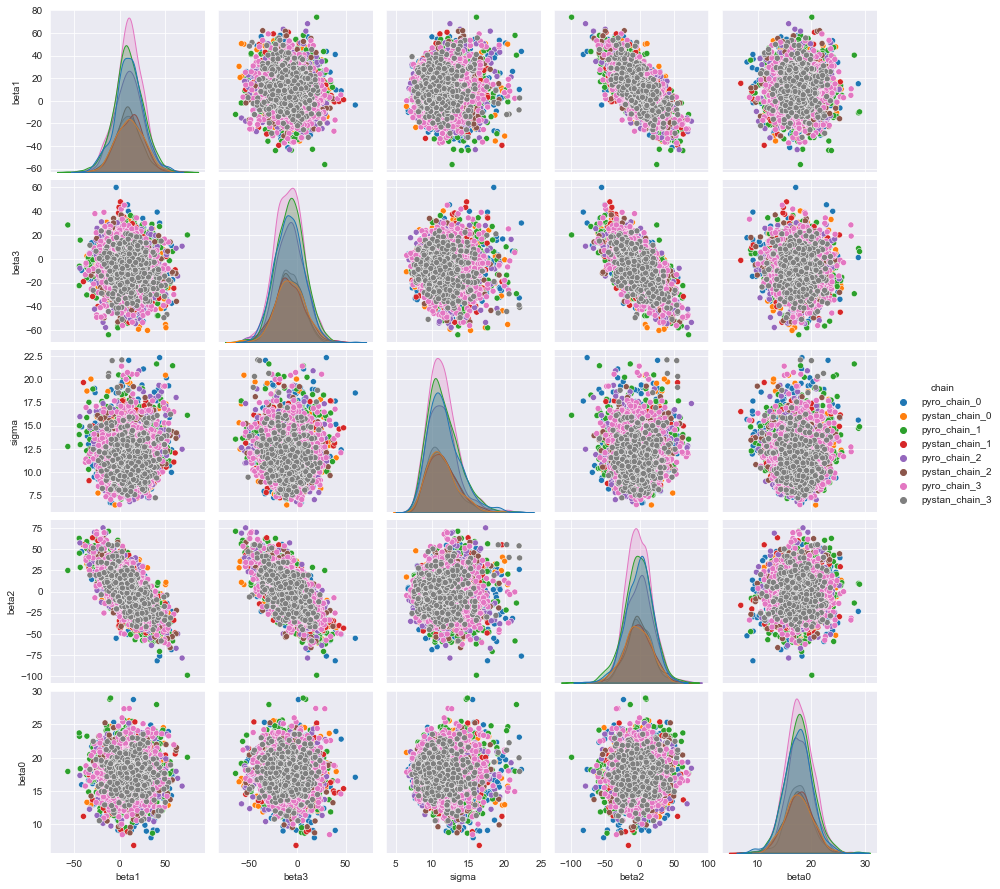

In [512]:
sns.pairplot(data=pyro_pystan_intermixing_chains_df, hue="chain");

In [522]:
# def pyro_pystan_param_histograms(parameter= "beta0", **kwargs):
#     fit_A_B_combined= pd.DataFrame()
#     for method, fit_df in kwargs.items():
#         fit_df["method"] = method
#         fit_A_B_combined= pd.concat([fit_A_B_combined, fit_df])
    
#     fit_A_B_combined= fit_A_B_combined[["chain", parameter, "method"]]
#     fig = px.histogram(fit_A_B_combined, x=parameter, color="method", marginal="rug", # can be `box`, `violin`
#                          hover_data=fit_A_B_combined.columns)
#     fig.update_layout(title_text="Histogram comparison between %s for parameter '%s'"%(list(kwargs.keys()), parameter))
#     fig.show()

In [523]:
# pyro_pystan_param_histograms(parameter="beta1", pyro=fit_df_A, pystan= fit_df_B)

base.pyro_pystan_param_histograms(parameter="beta1", pyro=fit_df_A, pystan= fit_df_B)

In [476]:
# # original_plus_simulated_data_prior = simulate_observations_given_prior_posterior_pairs(model_halfnormal_a= prior_samples_dict)

# original_plus_simulated_data_prior, obs_y_with_original_data_df = simulate_observations_given_prior_posterior_pairs(Y, prior_simulations=original_plus_simulated_data_prior, model_normal_a= prior_samples_dict)



___________

For model 'model_normal_a' posterior
total samples count: 1100  sample example:  [(-143.31483459472656, -386.7309875488281, -265.2214050292969, -223.08697509765625, 8.50705957708709e+34), (-22.07568359375, 511.3846740722656, -145.42103576660156, 178.79824829101562, 8.50705957708709e+34)]
Total execution time: 0.04134106636047363


_______________________________________________________
______________________________________________________________________
'posterior_day_X' corresponds to observations simulated from posterior of the given model, 'prior_day_X' corresponds to observations simulated from prior of the given model, 'day_X *' corresponds to the original observations for N-th day.


In [101]:
# def plot_original_y(original_obs,ylabel=None):
#     """

#     Input
#     -------
#     original_obs: original observations/ labels from given data

#     returns  plotly scatter plots with number of trials on X axis & corresponding probability of getting
#     shocked for each pair of (alpha, beta) passed in 'selected_pairs_list'.

#     Output
#     --------
#     Plots scatter plot of all observed values of y corresponding to each given pair of alpha, beta

#     """
#     num_obs = original_obs.shape[0] if original_obs.ndim!=1 else 1
#     obs_column_names = [f'Observation_{ind+1}' for ind in range(num_obs)] if num_obs!=1 else ["Observations"]
#     obs_y_df= pd.DataFrame(original_obs.T, columns=obs_column_names)

#     if ylabel is None:
#         ylabel = "Stack loss"

#     obs_y_title= "stack-loss distribution"
#     fig = px.scatter(obs_y_df, title=obs_y_title)
#     fig.update_layout(title=obs_y_title, xaxis_title="N-th Day", yaxis_title=ylabel, legend_title="Observation palette")
#     fig.show()

In [171]:
# prior_samples= prior_samples_dict

# parameters_pairs = list(zip(*list(prior_samples.values())))
# print("total samples count:", len(parameters_pairs), " sample example: ", parameters_pairs[:2])

total samples count: 1100  sample example:  [(-265.2381591796875, -316.151611328125, 499.641357421875, 12.219670295715332, 8.50705957708709e+34), (-503.770751953125, 295.54974365234375, 71.99957275390625, -256.0586853027344, 8.50705957708709e+34)]


In [367]:
# # Plot prior obs alongside original obs

# prior_samples= prior_samples_dict

# parameters_pairs = list(zip(*list(prior_samples.values())))
# abc= simulate_observations_given_param(parameters_pairs)

# abc_df_with_original_data = pd.DataFrame()

# abc_df= pd.DataFrame(abc)
# abc_df= abc_df.unstack().reset_index(level=0)
# abc_df.rename(columns={"level_0":"parameters", 0:"values"}, inplace=True)


# for param, groupdf in abc_df.groupby("parameters"):
# #     obs_number= int(n.split("_")[-1])
#     groupdf["parameters"] = "obs_%s"%(param+1)
# #     pd.DataFrame({"parameters":["original_obs_%s"%param], "values":[Y[param]]})
#     groupdf= groupdf.append({"parameters":"original_obs_%s"%(param+1), "values":Y[param].item()}, ignore_index=True)
#     abc_df_with_original_data= pd.concat([abc_df_with_original_data, groupdf])

# fig = px.box(abc_df_with_original_data, x="parameters", y="values")
# fig.update_layout(height=600, width=900, title_text="title")
# fig.show()

In [386]:
# # abc= np.clip(abc, -10, 10)
# abc_df= pd.DataFrame(abc, columns=["obs_%s"%(idx+1) for idx in range(abc.shape[1])])

# fig = px.violin(abc_df, box=True, # draw box plot inside the violin
#                 points='all', # can be 'outliers', or False
#                )
# fig.show()

In [387]:
# # abc= np.clip(abc, -10, 10)
# abc_df= pd.DataFrame(abc, columns=["obs_%s"%(idx+1) for idx in range(abc.shape[1])])

# fig = px.box(abc_df)
# fig.update_layout(height=600, width=900, title_text="title")
# fig.show()

In [301]:
# abc_df= pd.DataFrame(abc, columns=["obs_%s"%(idx+1) for idx in range(abc.shape[1])])

# fig = px.box(abc_df)
# fig.update_layout(height=600, width=900, title_text="title")
# fig.show()

In [401]:
# Plot prior obs alongside original obs

# prior_samples= prior_samples_dict
# parameters_pairs = list(zip(*list(prior_samples.values())))
# abc= simulate_observations_given_param(parameters_pairs)

# abc= np.clip(abc, -10, 10)
# plot_y_violin(abc)

In [471]:
# def simulate_observations_given_param(parameter_pair_list= [(72.2, 293.2, 506, 17.92, 8.5)]):
#     """
#     Input
#     -------



#     Output
#     --------
#     """
#     t1= time.time()
#     simulated_data_given_pair = []
    
#     for parameters in parameter_pair_list:
#         beta0, beta1, beta2, beta3, sigma= parameters
        
# #         beta0, beta1= np.clip(beta0, -10, 10), np.clip(beta1, -10, 10)
# #         beta2, beta3 = np.clip(beta2, -10, 10), np.clip(beta3, -10, 10)

#         mu= beta0 + beta1 * X1 + beta2 * X2 + beta3 * X3# (21,)
#         simulated_y= torch.normal(mu, np.sqrt(sigma))
        
# #         simulated_y= np.clip(simulated_y, 0, 100)

#         simulated_data_given_pair.append(simulated_y.numpy().reshape((1,-1)))

#     total_time= time.time()- t1
#     print("Total execution time: %s\n"%total_time)
    
#     simulated_data_arr= np.concatenate(simulated_data_given_pair, axis=0)
#     simulated_data_arr= np.clip(simulated_data_arr, -10, 10)
# #     simulated_data_arr=np.mean(simulated_data_arr, axis=0)
#     return simulated_data_arr

# def simulate_observations_given_prior_posterior_pairs(original_data, prior_simulations= None, **kwargs):
#     """
#     Input
#     -------



#     Output
#     --------
#     """
#     simulated_arr_list= []
#     flag = "posterior" if prior_simulations is not None else "prior"
#     for idx, content in enumerate(kwargs.items()):
#         model_name, samples_dict = content
#         print("___________\n\nFor model '%s' %s"%(model_name, flag))
#         parameters_pairs = list(zip(*list(samples_dict.values())))
#         print("total samples count:", len(parameters_pairs), " sample example: ", parameters_pairs[:2])
#         simulated_arr= simulate_observations_given_param(parameters_pairs)# shaped (1100, 21)
        
    
#     obs_y_with_original_data_df = plot_y_violin(simulated_arr, original_data, prior_simulations = prior_simulations)
# #   obs_y_with_original_data_df = base.plot_y_violin(simulated_arr)

#     return simulated_arr, obs_y_with_original_data_df
        

In [474]:
# def plot_y_violin(obs_y, original_obs, ylabel=None, prior_simulations=None):
#     """

#     Input
#     -------
#     obs_y: observations / labels 'Y' from given data.
#     original_obs: original ovbservation for given data.

#     returns  plotly violin plots with Nth day observation on X axis & corresponding stack loss
#     for each pair of (beta0, beta1, beta2, beta3, sigma) passed in 'selected_pairs_list'.

#     Output
#     --------
#     Plots violin plot of all observed values of y corresponding to each given pair of 
#     beta0, beta1, beta2, beta3, sigma

#     """
#     flag = "posterior" if prior_simulations is not None else "prior"
#     if ylabel is None:
#         ylabel = "Stack loss [original & simulated values]"
#     obs_y_with_original_data_df = pd.DataFrame()

#     obs_y_df= pd.DataFrame(obs_y)
#     obs_y_df= obs_y_df.unstack().reset_index(level=0)
#     obs_y_df.rename(columns={"level_0":"parameters", 0:"values"}, inplace=True)
    
#     note_text= "'%s_day_X' corresponds to observations simulated from %s of the given model, "%(flag, flag)
#     if prior_simulations is not None:#Df with original Y, prior & posterior
#         ylabel= 'Stack loss [original, simulated priors & posteriros]'
#         note_text+="'prior_day_X' corresponds to observations simulated from prior of the given model"
#         for param, groupdf in obs_y_df.groupby("parameters"):
#             index = param+1
#             prior_obs_df = pd.DataFrame({"parameters": "prior_day_%s"%(index), "values":prior_simulations[:, param]})
#             groupdf["parameters"] = "posterior_day_%s"%(index)
#             groupdf= groupdf.append({"parameters":"day_%s *"%(index), "values":original_obs[param].item()}, ignore_index=True)
#             obs_y_with_original_data_df = pd.concat([obs_y_with_original_data_df, prior_obs_df, groupdf])
#     else:#Df with Only original Y & posterior
#         for param, groupdf in obs_y_df.groupby("parameters"):
#             index = param+1
#             groupdf["parameters"] = "day_%s"%(index)
#             groupdf= groupdf.append({"parameters":"day_%s *"%(index), "values":Y[param].item()}, ignore_index=True)
#             obs_y_with_original_data_df = pd.concat([obs_y_with_original_data_df, groupdf])
    
#     note_text+=", 'day_X *' corresponds to the original observations for N-th day."
#     print("\n%s\n%s\n%s"%("_"*55, "_"*70, note_text))
#     obs_y_title= "stack-loss distribution"
#     # fig = px.box(obs_y_with_original_data_df, x="parameters", y="values")
#     fig = px.violin(obs_y_with_original_data_df, x="parameters", y="values", box=True, # draw box plot inside the violin
#                     points='all', # can be 'outliers', or False
#                 )
#     fig.update_layout(title=obs_y_title, height=600, width=900, xaxis_title="N-th Day observation", 
#                     yaxis_title=ylabel, legend_title="Observation palette")
#     fig.show()

#     return obs_y_with_original_data_df

In [40]:
# import statsmodels.api as sm
# X_sm = pd.DataFrame({"air_flow":X1, "water_temp":X2, "acid_conc":X3})
# X_sm = sm.add_constant(X_sm)
# Y_sm= Y
# model_sm = sm.OLS(Y_sm, X_sm)
# results_sm = model_sm.fit()

# print(results_sm.params)

const         17.571429
air_flow       9.864686
water_temp    -1.641466
acid_conc     -8.187153
dtype: float64


_______________